In [2]:
import os
import glob as glob
import imageio
import timecorr as tc
import hypertools as hyp
import numpy as np
import itertools
from scipy.io import loadmat
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline  
import timecorr as tc
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.colors as mcolors
from timecorr.helpers import isfc, wisfc, mean_combine, corrmean_combine


In [3]:

# calculate correlations  - returned squareformed
tc_vec_data = tc.timecorr(tc.simulate_data(datagen='ramping', return_corrs=False, set_random_seed=True, S=1, T=300, K=20, B=5), weights_function=tc.gaussian_weights, weights_params={'var': 5}, combine=tc.helpers.corrmean_combine)

# convert from vector to matrix format
wcorred_data = tc.vec2mat(tc_vec_data)


In [6]:
wcorred_data[:, :, 10].shape

(20, 20)

In [7]:
corred_labels = np.arange(0,20)

In [8]:
corred_labels

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19])

In [5]:
import networkx as nx

In [153]:
try_eig = nx.eigenvector_centrality(G)

In [154]:
G

In [129]:
positions=nx.circular_layout(try_eig)

KeyError: 1

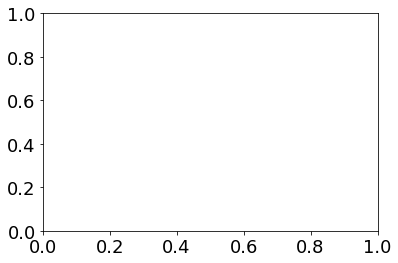

In [130]:
nx.draw_networkx_edges(H, positions, edge_list=edges,style='solid',
                      ###adds width=weights and edge_color = weights 
                      ###so that edges are based on the weight parameter 
                      ###edge_cmap is for the color scale based on the weight
                      ### edge_vmin and edge_vmax assign the min and max weights for the width
                      width=weights, edge_color = weights, edge_cmap = edge_colour,
                      edge_vmin = min(weights), edge_vmax=max(weights))

In [155]:
try_eig

{0: 0.223606797749979,
 1: 0.223606797749979,
 2: 0.223606797749979,
 3: 0.223606797749979,
 4: 0.223606797749979,
 5: 0.223606797749979,
 6: 0.223606797749979,
 7: 0.223606797749979,
 8: 0.223606797749979,
 9: 0.223606797749979,
 10: 0.223606797749979,
 11: 0.223606797749979,
 12: 0.223606797749979,
 13: 0.223606797749979,
 14: 0.223606797749979,
 15: 0.223606797749979,
 16: 0.223606797749979,
 17: 0.223606797749979,
 18: 0.223606797749979,
 19: 0.223606797749979}

In [124]:
import brainconn as bc

In [156]:
bc.centrality.eigenvector_centrality_und(wcorred_data[:, :, 10])

array([0.38902156, 0.12885794, 0.12500192, 0.08808783, 0.14918972,
       0.03984148, 0.14315794, 0.37661072, 0.25226681, 0.3455811 ,
       0.31027419, 0.06631417, 0.26351328, 0.07535639, 0.17258407,
       0.04364476, 0.03294778, 0.22106808, 0.23217676, 0.35790363])

In [157]:
G = nx.from_numpy_matrix(wcorred_data[:, :, 10])

#relabels the nodes to match the  stocks names
G = nx.relabel_nodes(G,lambda x: corred_labels[x])

#shows the edges with their corresponding weights
G.edges(data=True)

EdgeDataView([(0, 0, {'weight': 1.0}), (0, 1, {'weight': 0.15307313291344427}), (0, 2, {'weight': -0.024427999796346838}), (0, 3, {'weight': 0.04731581722149544}), (0, 4, {'weight': -0.43992305023240835}), (0, 5, {'weight': 0.0939993224715852}), (0, 6, {'weight': -0.013638095219518212}), (0, 7, {'weight': 0.3099049827020738}), (0, 8, {'weight': 0.21801770786335967}), (0, 9, {'weight': 0.36144918930945713}), (0, 10, {'weight': -0.13454185714505584}), (0, 11, {'weight': -0.1325724008265412}), (0, 12, {'weight': 0.16907844868559593}), (0, 13, {'weight': 0.03560621045920693}), (0, 14, {'weight': -0.07185302168171782}), (0, 15, {'weight': 0.2506054991656589}), (0, 16, {'weight': -0.12599214617886828}), (0, 17, {'weight': 0.11767091421173717}), (0, 18, {'weight': -0.17742416909369502}), (0, 19, {'weight': 0.2571751288048378}), (1, 1, {'weight': 1.0000000000000002}), (1, 2, {'weight': -0.028737943170767256}), (1, 3, {'weight': -0.01568680200788708}), (1, 4, {'weight': 0.03981820670332764}), (

In [131]:
def draw(G, pos, measures, measure_name):
    
    nodes = nx.draw_networkx_nodes(G, pos, node_size=250, cmap=plt.cm.plasma, 
                                   node_color=measures.values(),
                                   nodelist=measures.keys())
    nodes.set_norm(mcolors.SymLogNorm(linthresh=0.01, linscale=1))
    
    # labels = nx.draw_networkx_labels(G, pos)
    edges = nx.draw_networkx_edges(G, pos)

    plt.title(measure_name)
    plt.colorbar(nodes)
    plt.axis('off')
    plt.show()

In [135]:
G = nx.karate_club_graph()
pos = nx.spring_layout(G)

In [ ]:
G

TypeError: float() argument must be a string or a number, not 'dict_values'

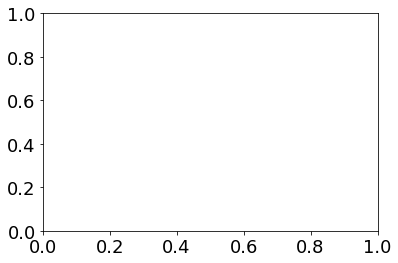

In [136]:
draw(G, pos, nx.degree_centrality(G), 'Degree Centrality')

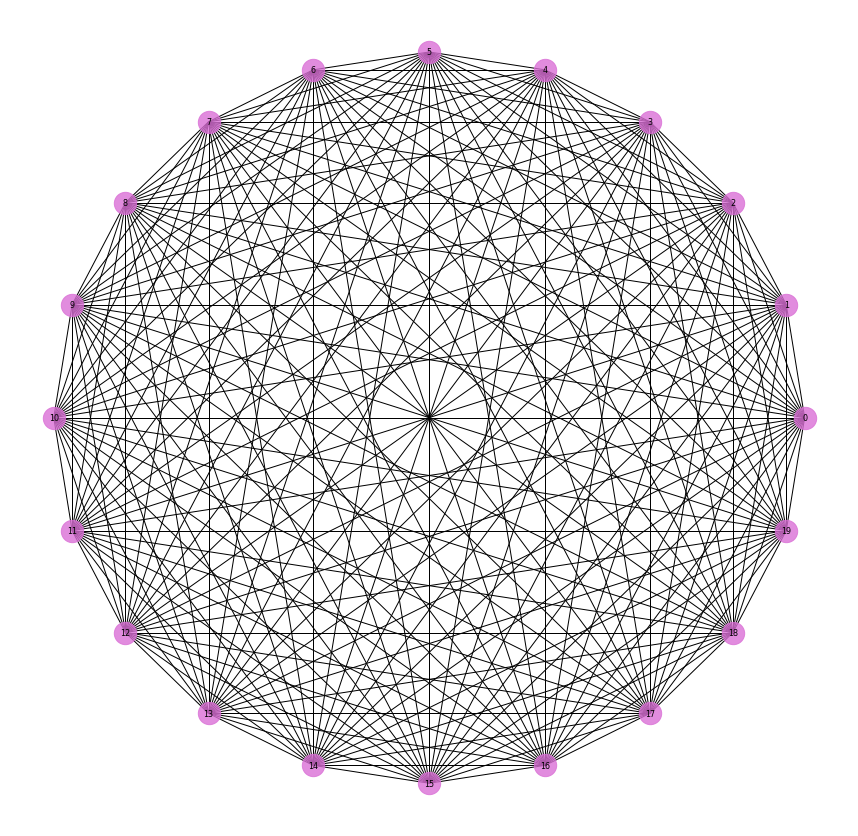

In [10]:

def create_corr_network_1(G):
    #crates a list for edges and for the weights
    edges,weights = zip(*nx.get_edge_attributes(G,'weight').items())

    #positions
    positions=nx.circular_layout(G)
    
    #Figure size
    plt.figure(figsize=(15,15))

    #draws nodes
    nx.draw_networkx_nodes(G,positions,node_color='#DA70D6',
                           node_size=500,alpha=0.8)
    
    #Styling for labels
    nx.draw_networkx_labels(G, positions, font_size=8, 
                            font_family='sans-serif')
        
    #draws the edges
    nx.draw_networkx_edges(G, positions, edge_list=edges,style='solid')
    
    # displays the graph without axis
    plt.axis('off')
    #saves image
    plt.savefig("part1.png", format="PNG")
    plt.show() 

create_corr_network_1(G)

In [21]:
def create_corr_network(G, corr_direction):

    ##Creates a copy of the graph
    H = G.copy()

    ##Checks all the edges and removes some based on corr_direction
    for stock1, stock2, weight in H.edges_iter(data=True):
        ##if we only want to see the positive correlations we then delete the edges with weight smaller than 0
        if corr_direction == "positive":
            if weight["weight"] <0:
                H.remove_edge(stock1, stock2)
        ##this part runs if the corr_direction is negative and removes edges with weights equal or largen than 0
        else:
            if weight["weight"] >=0:
                H.remove_edge(stock1, stock2)
                    
                    
    weights = tuple([(1+abs(x))**2 for x in weights])

    ###edge colors based on weight direction
    if corr_direction == "positive":
        edge_colour = plt.cm.GnBu 
    else:
        edge_colour = plt.cm.PuRd

    #positions
    positions=nx.circular_layout(G)
    
    #Figure size
    plt.figure(figsize=(15,15))
    #draws the edges
    nx.draw_networkx_edges(H, positions, edge_list=edges,style='solid',
                          ###adds width=weights and edge_color = weights 
                          ###so that edges are based on the weight parameter 
                          ###edge_cmap is for the color scale based on the weight
                          ### edge_vmin and edge_vmax assign the min and max weights for the width
                          width=weights, edge_color = weights, edge_cmap = edge_colour,
                          edge_vmin = min(weights), edge_vmax=max(weights))
    plt.axis('off')
    #saves image
    plt.savefig("part1.png", format="PNG")
    plt.show() 

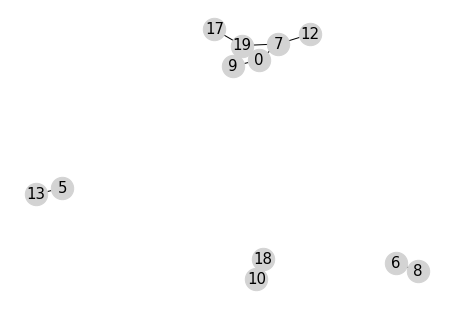

In [166]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
 
df = pd.DataFrame(wcorred_data[:, :, 10])

# Calculate the correlation between individuals. We have to transpose first, because the corr function calculate the pairwise correlations between columns.
corr = df.corr()
corr
 
# Transform it in a links data frame (3 columns only):
links = corr.stack().reset_index()
links.columns = ['var1', 'var2','value']
links
 
# Keep only correlation over a threshold and remove self correlation (cor(A,A)=1)
links_filtered=links.loc[ (links['value'] > 0.4) & (links['var1'] != links['var2']) ]
links_filtered
 
# Build your graph
G=nx.from_pandas_edgelist(links_filtered, 'var1', 'var2')

# Plot the network:
nx.draw(G, with_labels=True, node_color='lightgray', node_size=500, edge_color='black', linewidths=1, font_size=15)


In [167]:
d = dict(nx.eigenvector_centrality(G))

In [168]:
d

{0: 0.5095022979865694,
 7: 0.44908752936399293,
 9: 0.38986413312629886,
 19: 0.5640723727251128,
 5: 1.4905743393030506e-06,
 13: 1.4905743393030506e-06,
 6: 1.4905743393030506e-06,
 8: 1.4905743393030506e-06,
 12: 0.16308427419942542,
 10: 1.4905743393030506e-06,
 18: 1.4905743393030506e-06,
 17: 0.2048405107433742}

In [169]:
# G = nx.from_numpy_matrix(wcorred_data[:, :, 10])

# #relabels the nodes to match the  stocks names
# G = nx.relabel_nodes(G,lambda x: corred_labels[x])

# #shows the edges with their corresponding weights
# G.edges(data=True)
filter_weights = .1
H = G.copy()

##Checks all the edges and removes some based on corr_direction

for stock1, stock2 in G.edges:
    weight = G.edges[stock1, stock2]

    if abs(weight["weight"]) < filter_weights:
        H.remove_edge(stock1, stock2)


#crates a list for edges and for the weights
edges,weights = zip(*nx.get_edge_attributes(H,'weight').items())

### increases the value of weights, so that they are more visible in the graph
weights = tuple([(1+abs(x))**2 for x in weights])

#####calculates the degree of each node
#d = nx.degree(H)
#d = dict(H.degree())
d = dict(nx.degree_centrality(G))

#####creates list of nodes and a list their degrees that will be used later for their sizes
nodelist, node_sizes = zip(*d.items())

#positions
positions=nx.circular_layout(H)


#Figure size
plt.figure(figsize=(15,15))

#draws nodes
nx.draw_networkx_nodes(H,positions,node_color='lightgray',nodelist=nodelist,
                       #####the node size will be now based on its degree
                       node_size=tuple([x**3 for x in node_sizes]),alpha=0.8)

#Styling for labels
nx.draw_networkx_labels(H, positions, font_size=24, 
                        font_family='sans-serif')

###edge colors based on weight direction

edge_colour = plt.cm.RdBu 


#draws the edges
nx.draw_networkx_edges(H, positions, edge_list=edges,style='solid',
                      ###adds width=weights and edge_color = weights 
                      ###so that edges are based on the weight parameter 
                      ###edge_cmap is for the color scale based on the weight
                      ### edge_vmin and edge_vmax assign the min and max weights for the width
                      width=weights, edge_color = weights, edge_cmap = edge_colour,
                      edge_vmin = min(weights), edge_vmax=max(weights))

# displays the graph without axis
plt.axis('off')
#saves image
plt.savefig("part5" + str(filter_weights) + ".png", format="PNG")
plt.show() 

KeyError: 'weight'

In [104]:
H.

In [95]:
#function to create and display networks from the correlatin matrix. 

def create_corr_network(G, filter_weights):
    ##Creates a copy of the graph
    H = G.copy()
    
    ##Checks all the edges and removes some based on corr_direction
    
    for stock1, stock2 in G.edges:
        weight = G.edges[stock1, stock2]
        
        if abs(weight["weight"]) < filter_weights:
            print(weight["weight"])
            H.remove_edge(stock1, stock2)

                
    
    #crates a list for edges and for the weights
    edges,weights = zip(*nx.get_edge_attributes(H,'weight').items())
    
    ### increases the value of weights, so that they are more visible in the graph
    weights = tuple([(1+abs(x))**2 for x in weights])
    
    #####calculates the degree of each node
    #d = nx.degree(H)
    d = dict(H.degree())
    #####creates list of nodes and a list their degrees that will be used later for their sizes
    nodelist, node_sizes = zip(*d.items())

    #positions
    positions=nx.circular_layout(H)
    
    #Figure size
    plt.figure(figsize=(15,15))

    #draws nodes
    nx.draw_networkx_nodes(H,positions,node_color='lightgray',nodelist=nodelist,
                           #####the node size will be now based on its degree
                           node_size=tuple([x**3 for x in node_sizes]),alpha=0.8)
    
    #Styling for labels
    nx.draw_networkx_labels(H, positions, font_size=24, 
                            font_family='sans-serif')
    
    ###edge colors based on weight direction

    edge_colour = plt.cm.RdBu 

        
    #draws the edges
    nx.draw_networkx_edges(H, positions, edge_list=edges,style='solid',
                          ###adds width=weights and edge_color = weights 
                          ###so that edges are based on the weight parameter 
                          ###edge_cmap is for the color scale based on the weight
                          ### edge_vmin and edge_vmax assign the min and max weights for the width
                          width=weights, edge_color = weights, edge_cmap = edge_colour,
                          edge_vmin = min(weights), edge_vmax=max(weights))

    # displays the graph without axis
    plt.axis('off')
    #saves image
    plt.savefig("part5" + str(filter_weights) + ".png", format="PNG")
    plt.show() 

-0.024427999796346838
0.04731581722149544
0.0939993224715852
-0.013638095219518212
0.03560621045920693
-0.07185302168171782
-0.028737943170767256
-0.01568680200788708
0.03981820670332764
-0.04054313839126811
-0.05533920413413761
0.09021224277216255
-0.03886036937454589
-0.038936543942769956
0.07518130288894163
0.06651960566563009
0.02310953547412079
-0.031592286881058695
-0.025182751788497076
-0.04707346005747411
0.09920113576870902
-0.042930628633547435
0.03146433151505767
-0.03163223238421154
-0.007859244281918486
-0.05615581864639777
0.03841164841021151
0.06336225564844086
-0.07692720459963148
-0.0821263958551662
0.003730108690578815
-0.05705582063161086
0.04365838534019341
-0.022556573907740244
0.06381897088598701
-0.0745787825002358
-0.061622872582952334
0.032771807828656484
-0.06237101042251435
-0.04317931252750015
0.05306150011931514
0.012586068096669453
-0.07141298472156565
0.018381772430618202
-0.06269883992133582
-0.07314321896552205
0.07671934096658742
-0.08041678625230966
0

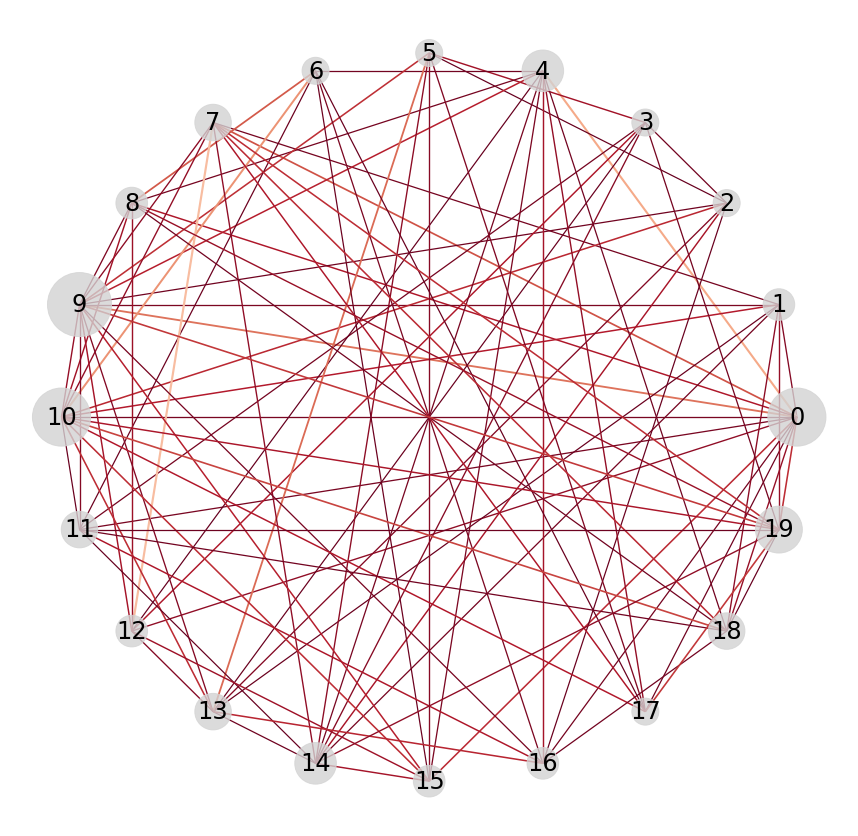

In [97]:
create_corr_network(G,filter_weights=0.1) 

In [93]:
create_corr_network(G,corr_direction='positive', min_correlation= -0.1) 

TypeError: create_corr_network() got an unexpected keyword argument 'corr_direction'

In [159]:
links_filtered=currmat.loc[(links['value'] > 0.8) & (links['var1'] != links['var2']) ]
links_filtered
 
# Build your graph
G=nx.from_pandas_dataframe(links_filtered, 'var1', 'var2')
 
# Plot the network:
nx.draw(G, with_labels=True, node_color='orange', node_size=400, edge_color='black', linewidths=1, font_size=15)


AttributeError: 'numpy.ndarray' object has no attribute 'loc'

In [109]:
df

,A,B,C,D,E,F,G,H,I,J
0,5,13,10,5,8,1,2,4,1,2
1,10,17,13,13,12,1,2,1,4,3
2,3,5,3,5,6,13,13,14,15,15
3,4,10,5,8,8,4,8,8,4,5
4,8,15,9,8,8,18,20,20,18,18
5,10,12,13,14,10,5,9,5,5,7
6,12,19,14,12,13,2,2,3,5,5
7,1,8,9,3,1,11,14,14,14,14
8,9,12,18,9,11,3,4,7,7,3
9,4,12,5,4,4,8,12,9,8,8


In [110]:
links

,var1,var2,value
0,A,A,1.000000
1,A,B,0.814336
2,A,C,0.753473
3,A,D,0.898857
4,A,E,0.915790
5,A,F,-0.409401
6,A,G,-0.465920
7,A,H,-0.503619
8,A,I,-0.354197
9,A,J,-0.406725


In [160]:
df = pd.DataFrame(wcorred_data[:, :, 10])

In [161]:
df

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,1.000000,0.153073,-0.024428,0.047316,-0.439923,0.093999,-0.013638,0.309905,0.218018,0.361449,-0.134542,-0.132572,0.169078,0.035606,-0.071853,0.250605,-0.125992,0.117671,-0.177424,0.257175
1,0.153073,1.000000,-0.028738,-0.015687,0.039818,-0.040543,-0.055339,0.126916,0.090212,0.136894,0.224612,-0.038860,-0.038937,0.109312,-0.128443,0.075181,0.066520,0.023110,-0.163347,0.178661
2,-0.024428,-0.028738,1.000000,-0.124293,-0.031592,-0.100721,-0.025183,-0.047073,0.099201,0.118187,-0.247258,-0.042931,0.031464,-0.149402,-0.204692,-0.031632,-0.106095,-0.007859,-0.056156,0.038412
3,0.047316,-0.015687,-0.124293,1.000000,0.063362,0.195846,-0.076927,-0.082126,0.003730,-0.057056,0.043658,0.126377,-0.213920,0.105949,0.154426,-0.022557,0.063819,-0.074579,-0.061623,0.129152
4,-0.439923,0.039818,-0.031592,0.063362,1.000000,0.032772,0.122601,-0.062371,0.125613,-0.233934,-0.043179,0.053062,0.104254,0.012586,0.131486,-0.135261,-0.200724,0.176807,0.121399,-0.071413
5,0.093999,-0.040543,-0.100721,0.195846,0.032772,1.000000,0.018382,-0.062699,-0.073143,0.258641,0.076719,-0.080417,0.039575,0.345781,0.165047,0.158416,0.073570,-0.147152,-0.009289,-0.079565
6,-0.013638,-0.055339,-0.025183,-0.076927,0.122601,0.018382,1.000000,0.014346,0.325176,0.094476,-0.408771,0.113150,-0.047070,0.043655,-0.015587,-0.111506,0.135023,0.109435,0.045351,0.066109
7,0.309905,0.126916,-0.047073,-0.082126,-0.062371,-0.062699,0.014346,1.000000,-0.029884,0.164910,-0.173812,-0.093259,0.473724,-0.054419,-0.170194,-0.021789,0.095448,0.217764,-0.250920,0.253998
8,0.218018,0.090212,0.099201,0.003730,0.125613,-0.073143,0.325176,-0.029884,1.000000,0.142833,-0.199219,-0.013226,0.188224,0.005833,-0.072842,-0.012791,-0.055854,0.096120,-0.124029,0.183141
9,0.361449,0.136894,0.118187,-0.057056,-0.233934,0.258641,0.094476,0.164910,0.142833,1.000000,-0.178196,-0.153730,0.203153,0.150223,-0.059391,0.232139,0.132409,0.086214,-0.020888,0.273227


In [162]:
corr

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,1.000000,0.230518,0.049185,-0.087264,-0.695797,0.045416,-0.067410,0.519386,0.288538,0.641033,-0.259985,-0.316430,0.324640,-0.099691,-0.237961,0.294503,-0.139329,0.157955,-0.419447,0.491724
1,0.230518,1.000000,-0.070072,-0.094072,-0.141011,-0.150171,-0.218420,0.190881,0.055919,0.145876,0.241954,-0.149574,-0.081034,0.103194,-0.320766,0.021374,0.053653,-0.009723,-0.313838,0.253660
2,0.049185,-0.070072,1.000000,-0.293863,-0.065383,-0.270068,0.059559,0.031292,0.241873,0.198161,-0.420354,-0.076257,0.111061,-0.385077,-0.395821,-0.150877,-0.209209,0.057540,-0.130917,0.158744
3,-0.087264,-0.094072,-0.293863,1.000000,0.034518,0.291174,-0.171909,-0.293539,-0.162664,-0.240598,0.117838,0.179202,-0.474402,0.215115,0.257107,-0.129062,0.081256,-0.222893,-0.100796,0.000713
4,-0.695797,-0.141011,-0.065383,0.034518,1.000000,-0.102312,0.177003,-0.248368,0.084951,-0.563563,-0.038610,0.102507,-0.022774,-0.098047,0.220640,-0.385019,-0.339398,0.154601,0.227326,-0.243612
5,0.045416,-0.150171,-0.270068,0.291174,-0.102312,1.000000,-0.125582,-0.224781,-0.269076,0.252859,0.214353,-0.186207,-0.104634,0.546170,0.334095,0.210575,0.101067,-0.418077,0.009095,-0.286653
6,-0.067410,-0.218420,0.059559,-0.171909,0.177003,-0.125582,1.000000,-0.001591,0.507411,0.076607,-0.655792,0.185276,-0.086854,-0.084431,-0.130500,-0.393597,0.148758,0.233591,-0.082767,0.126765
7,0.519386,0.190881,0.031292,-0.293539,-0.248368,-0.224781,-0.001591,1.000000,0.088097,0.350535,-0.386867,-0.206369,0.655729,-0.273628,-0.383184,-0.088088,0.047314,0.359132,-0.504477,0.502191
8,0.288538,0.055919,0.241873,-0.162664,0.084951,-0.269076,0.507411,0.088097,1.000000,0.201178,-0.507922,-0.074066,0.229121,-0.228092,-0.255173,-0.230177,-0.198445,0.200650,-0.304129,0.342968
9,0.641033,0.145876,0.198161,-0.240598,-0.563563,0.252859,0.076607,0.350535,0.201178,1.000000,-0.325086,-0.368711,0.297134,0.045524,-0.244815,0.238179,0.110316,0.077144,-0.253749,0.439251


In [163]:
links

,var1,var2,value
0,0,0,1.000000
1,0,1,0.230518
2,0,2,0.049185
3,0,3,-0.087264
4,0,4,-0.695797
5,0,5,0.045416
6,0,6,-0.067410
7,0,7,0.519386
8,0,8,0.288538
9,0,9,0.641033


In [250]:
links

,var1,var2,value
0,0,0,1.000000
1,0,1,0.230518
2,0,2,0.049185
3,0,3,-0.087264
4,0,4,-0.695797
5,0,5,0.045416
6,0,6,-0.067410
7,0,7,0.519386
8,0,8,0.288538
9,0,9,0.641033


In [256]:
links_filtered

,var1,var2,value
1,0,1,0.230518
2,0,2,0.049185
3,0,3,-0.087264
5,0,5,0.045416
6,0,6,-0.067410
7,0,7,0.519386
8,0,8,0.288538
9,0,9,0.641033
10,0,10,-0.259985
11,0,11,-0.316430


In [133]:
def draw(G, pos, measures, measure_name, hubs=None, outfile=None):
    fig, ax = plt.subplots(figsize=(20, 10))
    
    if hubs:
        labels = {}    
        for node in G.nodes():
            if node in hubs:
                #set the node name as the key and the label as its value 
                labels[node] = node
    
        nodes = nx.draw_networkx_nodes(G, pos, node_size=500, with_labels=False, cmap=plt.cm.plasma, 
                                   node_color=list(measures.values()),
                                   nodelist=measures.keys(), font_size=15, vmin=-1, vmax=1, center=0)
        
        nx.draw_networkx_labels(G,pos,labels,font_size=20,bbox=dict(facecolor='white', alpha=0.5), font_color='k')
    
    else:
        
        nodes = nx.draw_networkx_nodes(G, pos, node_size=500, with_labels=True, cmap=plt.cm.plasma, 
                                       node_color=list(measures.values()),
                                       nodelist=measures.keys(), alpha=.25, font_size=15, vmin=-1, vmax=1, center=0)
        labels = nx.draw_networkx_labels(G, pos)

    nodes.set_norm(mcolors.SymLogNorm(linthresh=0.01, linscale=1))
    
    for u,v,a in G.edges(data=True):
        print(u, v, a)
    edges = nx.draw_networkx_edges(G, pos)

    plt.title(measure_name)
    #plt.colorbar(nodes)
    cbar = fig.colorbar(nodes, ticks=[-1, 0, 1])
    cbar.ax.set_yticklabels(['< -1', '0', '> 1']) 
    plt.axis('off')
    if outfile:
        plt.savefig(outfile)

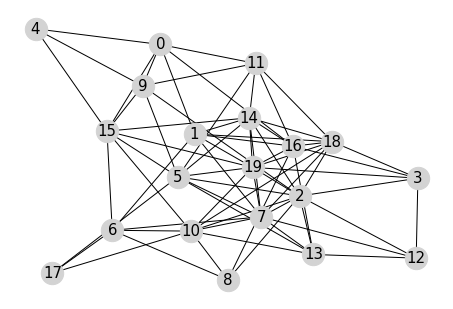

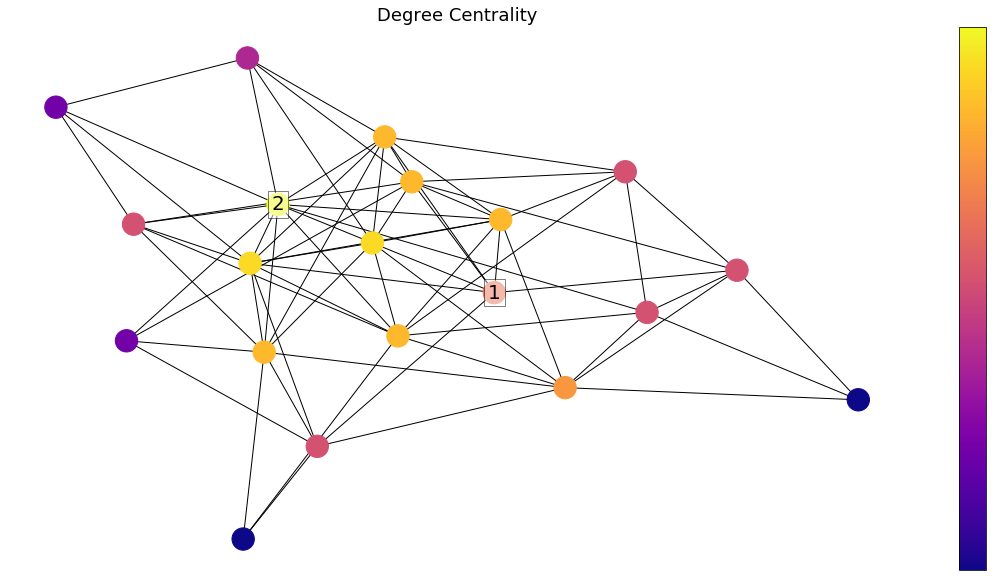

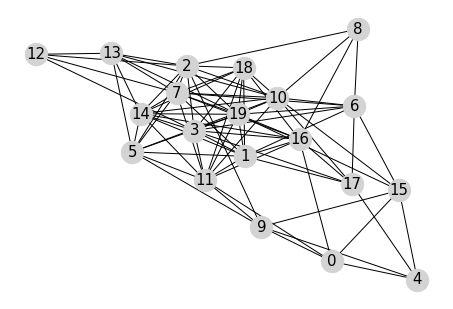

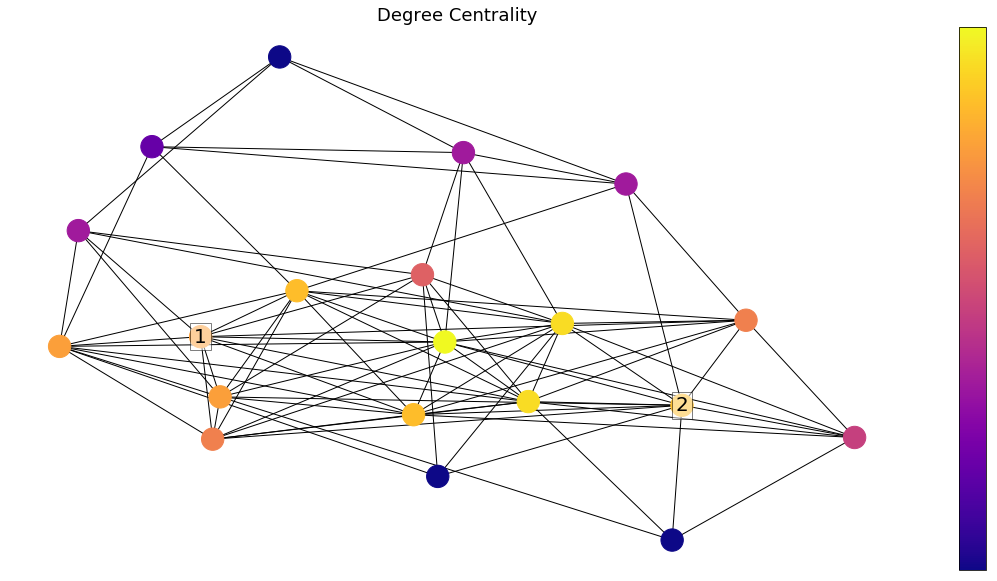

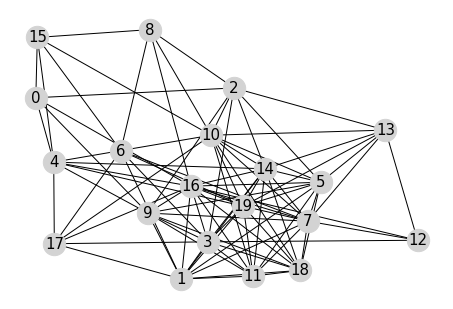

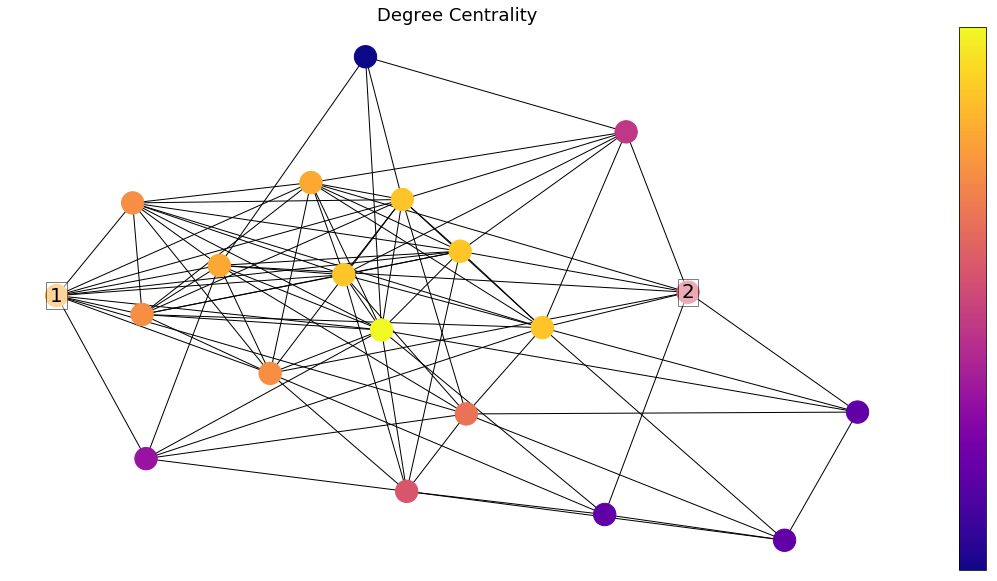

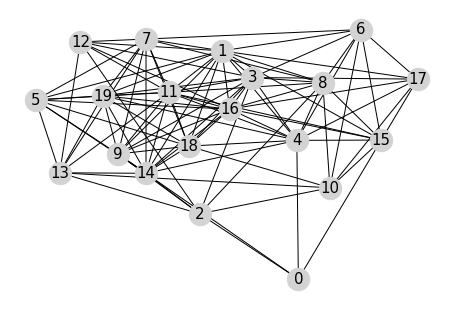

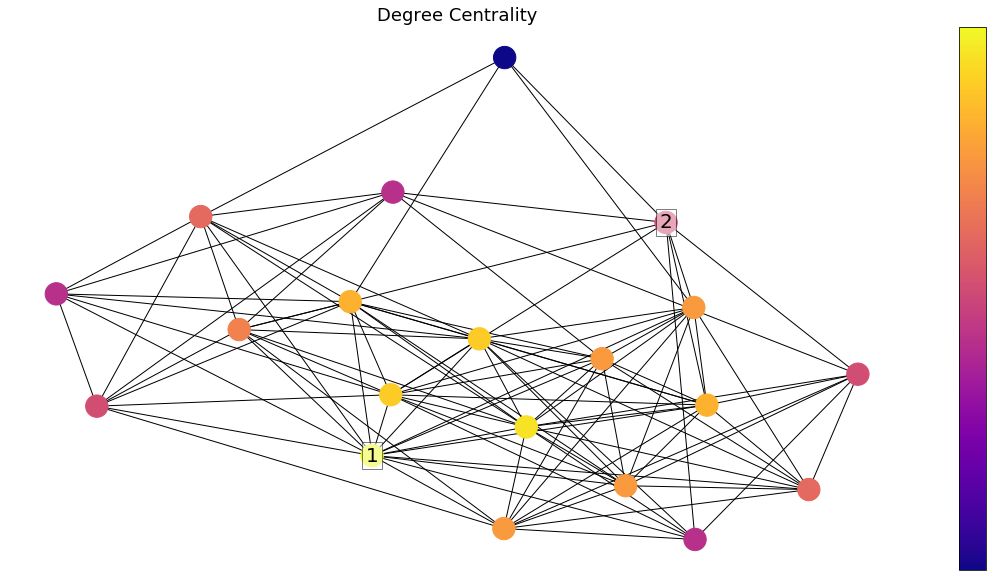

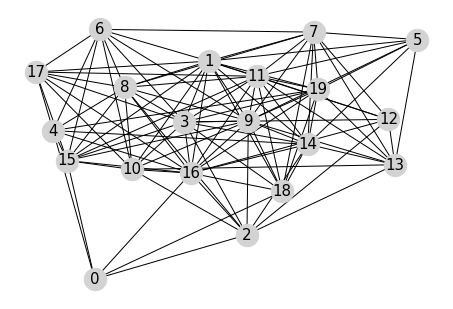

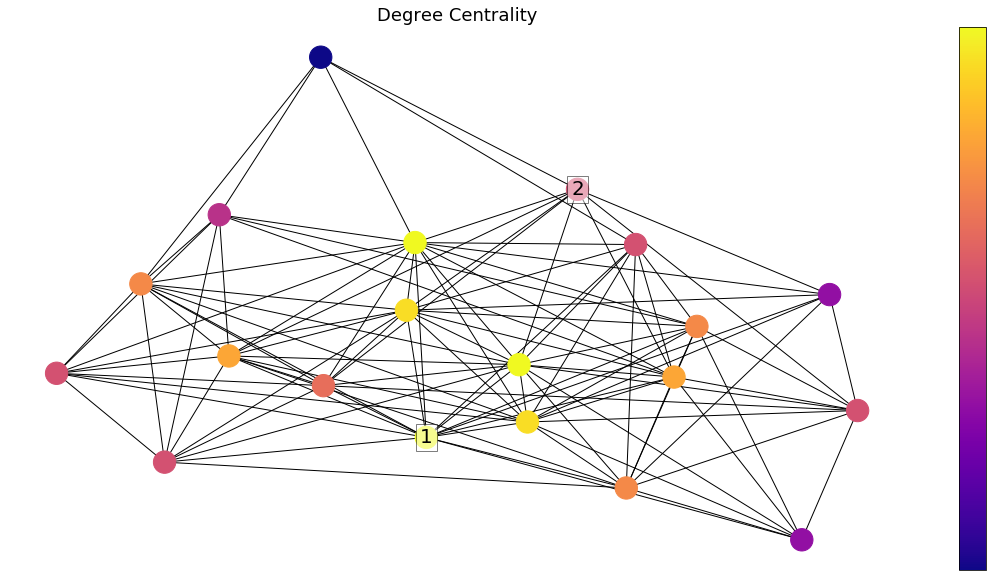

<Figure size 432x288 with 0 Axes>

In [60]:
gif_path = '/Users/lucyowen/Desktop/eig_try'

if not os.path.exists(gif_path):
    os.makedirs(gif_path)

for x in np.arange(50, 55, 1):
    
    df = pd.DataFrame(wcorred_data[:, :, x])

    # Calculate the correlation between individuals. We have to transpose first, because the corr function calculate the pairwise correlations between columns.
    corr = df.corr()
    corr

    # Transform it in a links data frame (3 columns only):
    links = corr.stack().reset_index()
    links.columns = ['var1', 'var2','value']
    links

    # Keep only correlation over a threshold and remove self correlation (cor(A,A)=1)
    links_filtered=links.loc[ (abs(links['value']) > 0.25) & (links['var1'] != links['var2']) ]

    links_filtered

    # Build your graph
    G=nx.from_pandas_edgelist(links_filtered, 'var1', 'var2')

    # Plot the network:
    nx.draw(G, with_labels=True, node_color='lightgray', node_size=500, edge_color='black', linewidths=1, font_size=15)

    pos = nx.spring_layout(G)
    
    outfile = os.path.join(gif_path, str(x).zfill(6) + '.png')
    

    draw(G, pos, nx.degree_centrality(G), 'Degree Centrality', hubs = [1, 2], outfile=outfile)
    plt.show()
    plt.clf()

In [21]:
name='eig_gif'


images = []
for file in os.listdir(gif_path):
    if file.endswith(".png"):
        images.append(imageio.imread(os.path.join(gif_path, file)))

    
gif_outfile = os.path.join(gif_path, name + '.gif')  
imageio.mimsave(gif_outfile, images)


In [23]:
char_data = np.load('/Users/lucyowen/Desktop/dyna_mat_112_112_49.npy')

In [27]:
char_data

array([[[ 1.00000000e+000,  1.00000000e+000,  1.00000000e+000, ...,
          1.00000000e+000,  1.00000000e+000,  1.00000000e+000],
        [ 9.68910860e-002,  8.51521457e-002,  1.87204492e-001, ...,
          6.91556365e-002,  3.29873656e-001,  5.29222420e-001],
        [-5.93142273e-001, -4.93173533e-001, -3.52976698e-001, ...,
         -2.07618401e-001, -1.10436454e-001, -1.64815563e-002],
        ...,
        [ 3.74912179e-001,  3.85540882e-001,  3.87907175e-001, ...,
          4.61164799e-001,  1.77932033e-001,  1.71197222e-001],
        [ 9.30635167e-002,  6.86079136e-002,  3.76373615e-002, ...,
          2.60404546e-001, -1.81496690e-001, -4.61284438e-001],
        [ 7.97987746e-002,  6.20480223e-002,  3.92413009e-002, ...,
          2.39723198e-001, -1.64030604e-001, -4.31088675e-001]],

       [[ 9.68910860e-002,  8.51521457e-002,  1.87204492e-001, ...,
          6.91556365e-002,  3.29873656e-001,  5.29222420e-001],
        [ 1.00000000e+000,  1.00000000e+000,  1.00000000e+000

In [44]:
char_list = ['bianca',
 'cameron',
 'clint eastwood',
 'dakota',
 'dart',
 'james',
 'karen mccullah lutz kirsten smith',
 'marley',
 'merlot',
 'michael',
 'north',
 'patrick',
 'perky',
 'semi',
 'thirtytwo',
 'william shakespeare',
 'hemingway',
 'kat kat',
 'katarina stratford',
 'mr',
 'ms',
 'wrangler',
 'kat',
 'colette charlotte',
 'mandella',
 'pat verona',
 'joey',
 's',
 'tragic',
 'joyful',
 'moms',
 'permashitgrin',
 'remove',
 'sharon',
 'viper',
 'william',
 'jesus',
 'mrs',
 'sarah lawrence',
 'walter nowhere',
 'andrew barrett',
 'johnson',
 'roxanne korrine',
 'walter',
 'a coffee kid',
 'boengie',
 'cosia rican',
 'scurvy',
 'fine',
 'janice parker',
 'marilyn manson',
 'nelson mandela',
 'trevor',
 'verona',
 'woman',
 'blaupunkt',
 'vintage',
 'cells a coffee kid',
 'dorsey',
 'jock',
 'will bogey',
 'bogey lowenbraus',
 'bogey lowenstein',
 'jared leto',
 'katarina',
 'lou',
 'gigglepuss',
 'likes thai',
 'bruce',
 'victorias secret',
 'no bikini kill',
 'cruella',
 'kenneth',
 'ninethirty',
 'rick',
 'gloria steinem',
 'levis',
 'mandellas',
 'padua highs',
 'daddy',
 'jock a',
 'yo clem',
 'ziggy',
 'ill',
 'int',
 'queen harry',
 'bonchowski',
 'wanna',
 'clem',
 'damn',
 'derek ms',
 'shakespeare',
 'archie',
 'betty',
 'veronica',
 'pat',
 'sacrifice',
 'wholesome',
 'chapin',
 'michael sweet',
 'cmon',
 'start',
 'century',
 'hearsay',
 'love lucy',
 'mommy',
 'girl',
 'molly ringwald',
 'fender stratocaster',
 'lucentio',
 'rises',
 'strat']

In [45]:
char_list

['bianca',
 'cameron',
 'clint eastwood',
 'dakota',
 'dart',
 'james',
 'karen mccullah lutz kirsten smith',
 'marley',
 'merlot',
 'michael',
 'north',
 'patrick',
 'perky',
 'semi',
 'thirtytwo',
 'william shakespeare',
 'hemingway',
 'kat kat',
 'katarina stratford',
 'mr',
 'ms',
 'wrangler',
 'kat',
 'colette charlotte',
 'mandella',
 'pat verona',
 'joey',
 's',
 'tragic',
 'joyful',
 'moms',
 'permashitgrin',
 'remove',
 'sharon',
 'viper',
 'william',
 'jesus',
 'mrs',
 'sarah lawrence',
 'walter nowhere',
 'andrew barrett',
 'johnson',
 'roxanne korrine',
 'walter',
 'a coffee kid',
 'boengie',
 'cosia rican',
 'scurvy',
 'fine',
 'janice parker',
 'marilyn manson',
 'nelson mandela',
 'trevor',
 'verona',
 'woman',
 'blaupunkt',
 'vintage',
 'cells a coffee kid',
 'dorsey',
 'jock',
 'will bogey',
 'bogey lowenbraus',
 'bogey lowenstein',
 'jared leto',
 'katarina',
 'lou',
 'gigglepuss',
 'likes thai',
 'bruce',
 'victorias secret',
 'no bikini kill',
 'cruella',
 'kenneth'

In [48]:
df.columns = char_list

In [49]:
df.columns

Index(['bianca', 'cameron', 'clint eastwood', 'dakota', 'dart', 'james',
       'karen mccullah lutz kirsten smith', 'marley', 'merlot', 'michael',
       ...
       'century', 'hearsay', 'love lucy', 'mommy', 'girl', 'molly ringwald',
       'fender stratocaster', 'lucentio', 'rises', 'strat'],
      dtype='object', length=112)

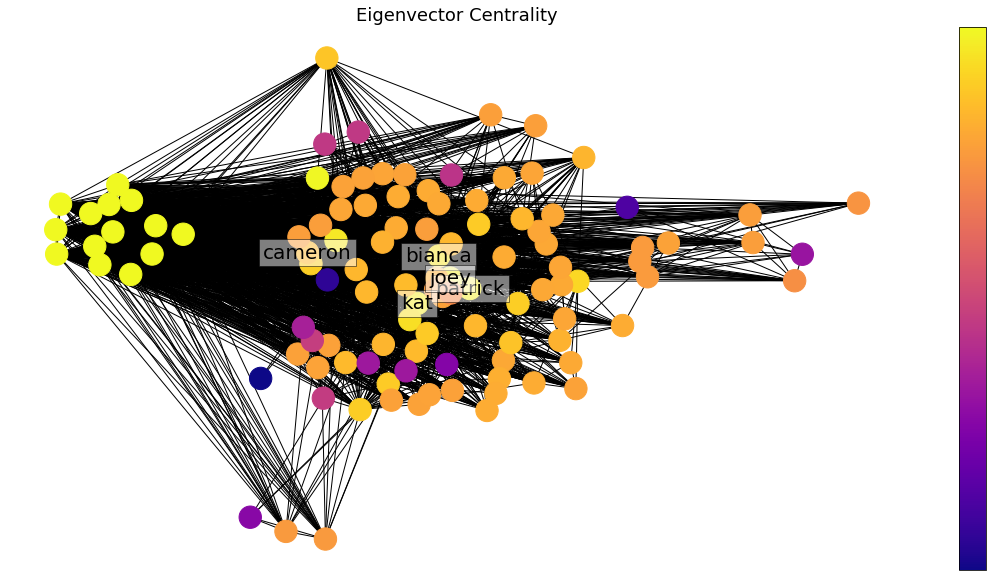

<Figure size 432x288 with 0 Axes>

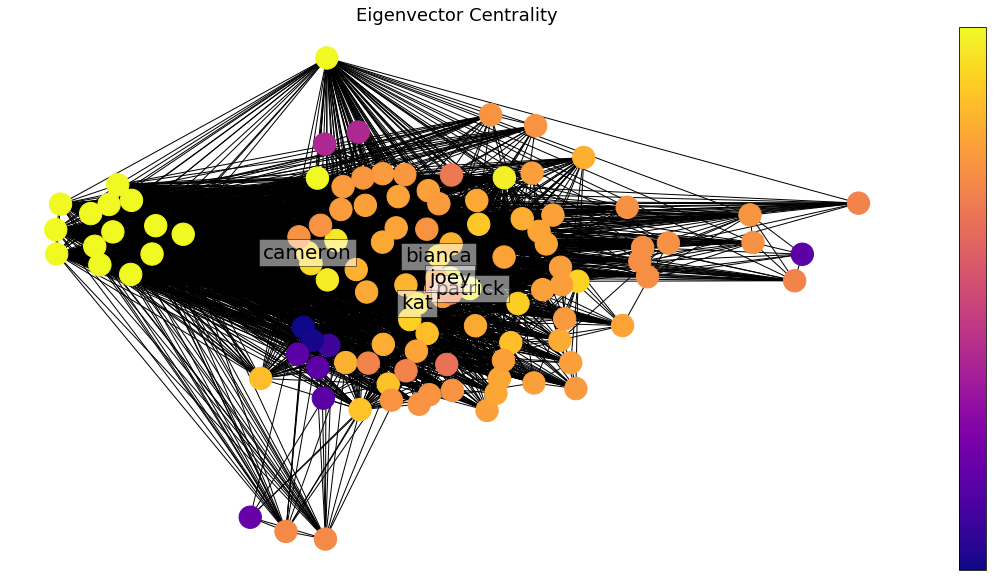

<Figure size 432x288 with 0 Axes>

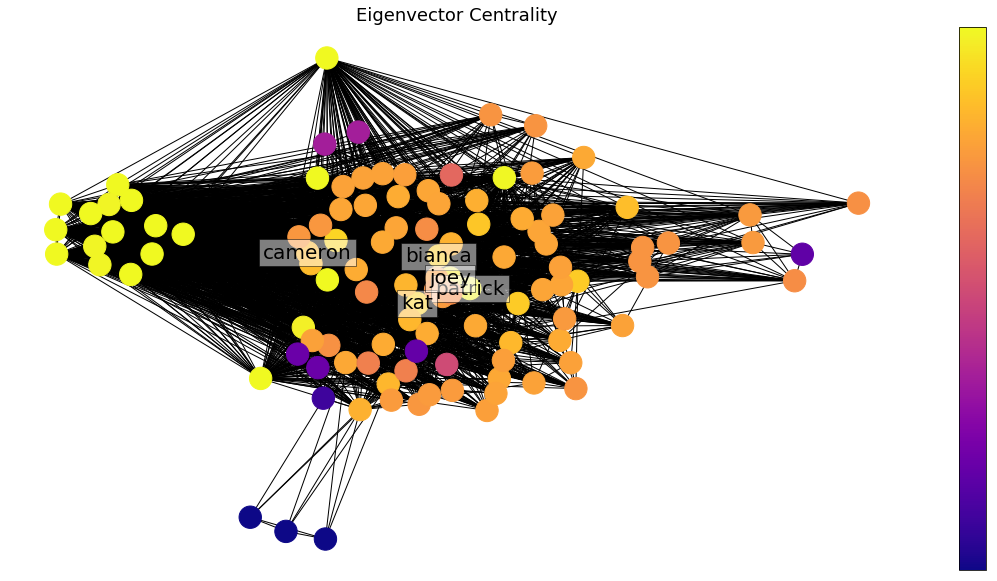

<Figure size 432x288 with 0 Axes>

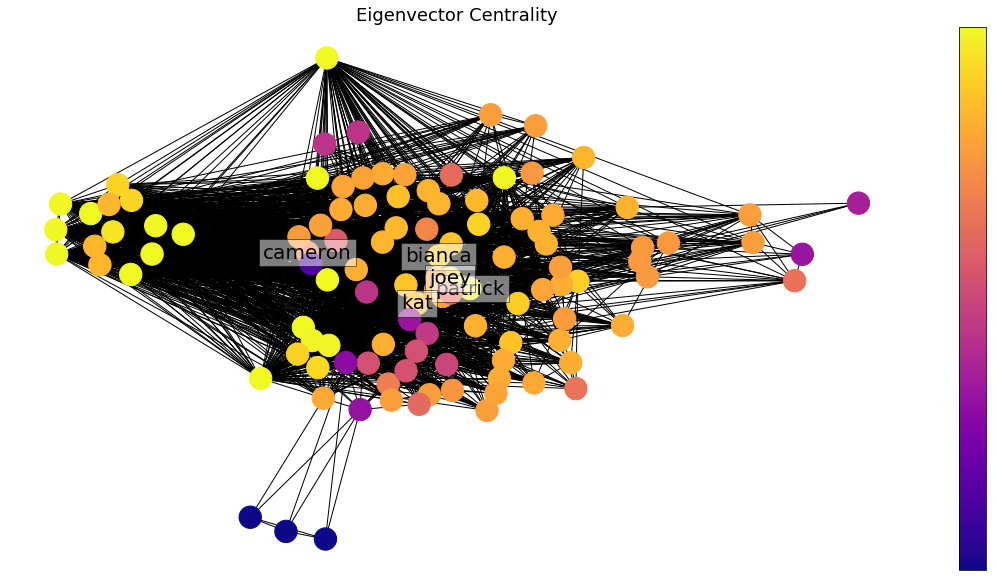

<Figure size 432x288 with 0 Axes>

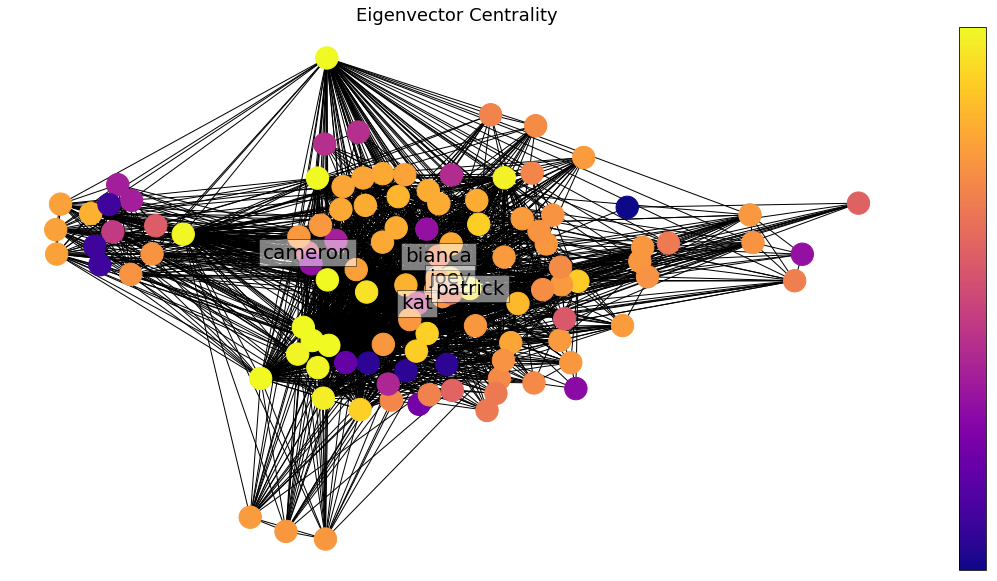

<Figure size 432x288 with 0 Axes>

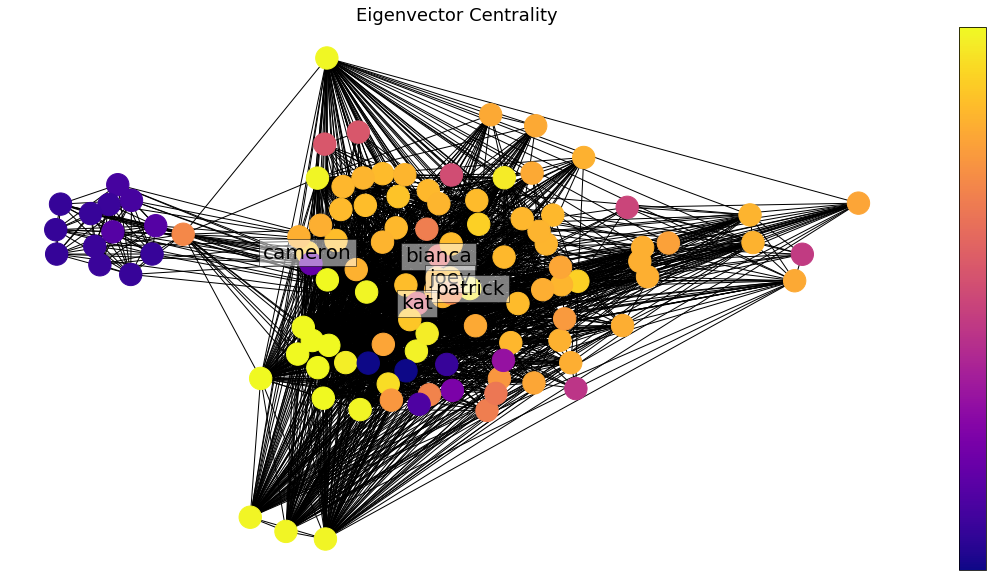

<Figure size 432x288 with 0 Axes>

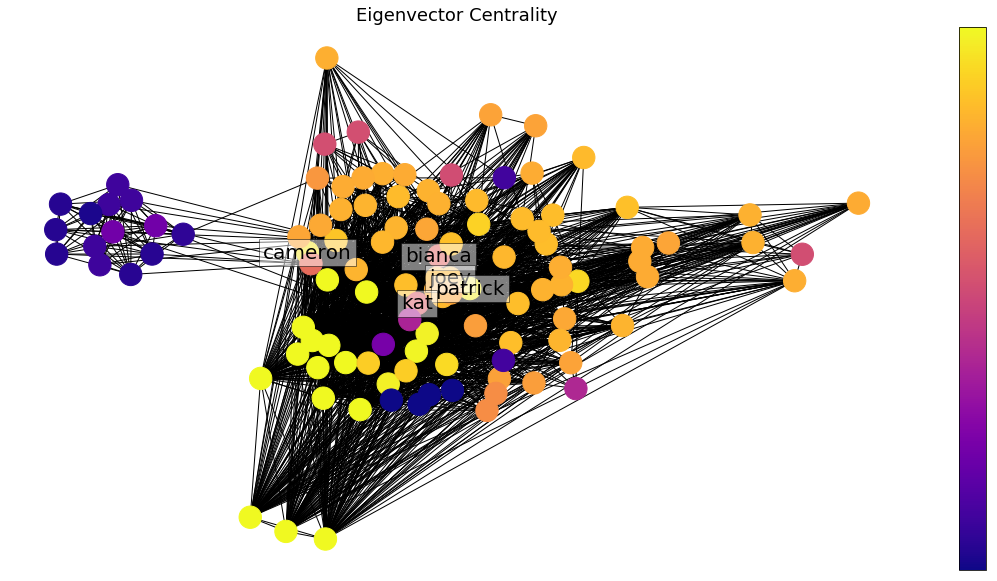

<Figure size 432x288 with 0 Axes>

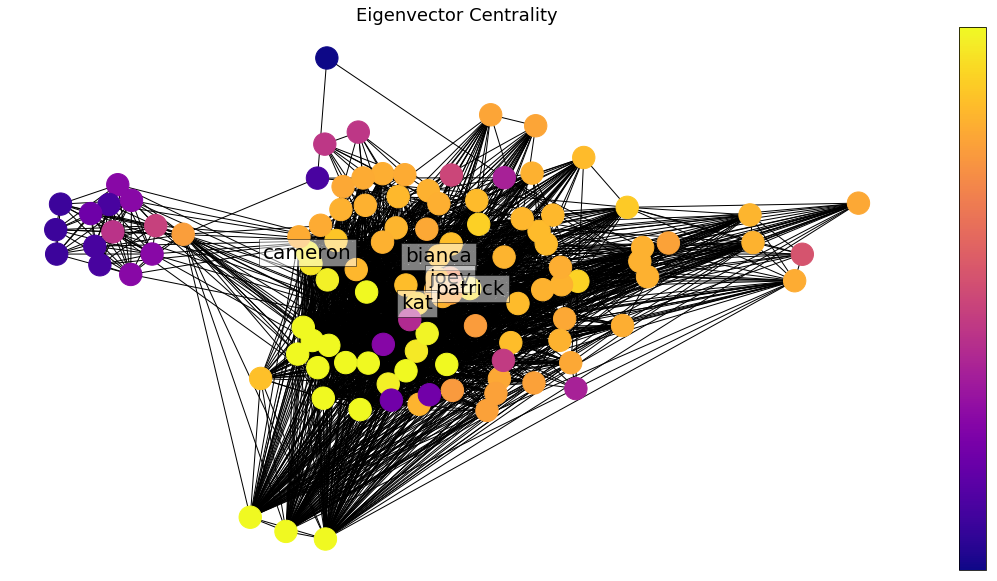

<Figure size 432x288 with 0 Axes>

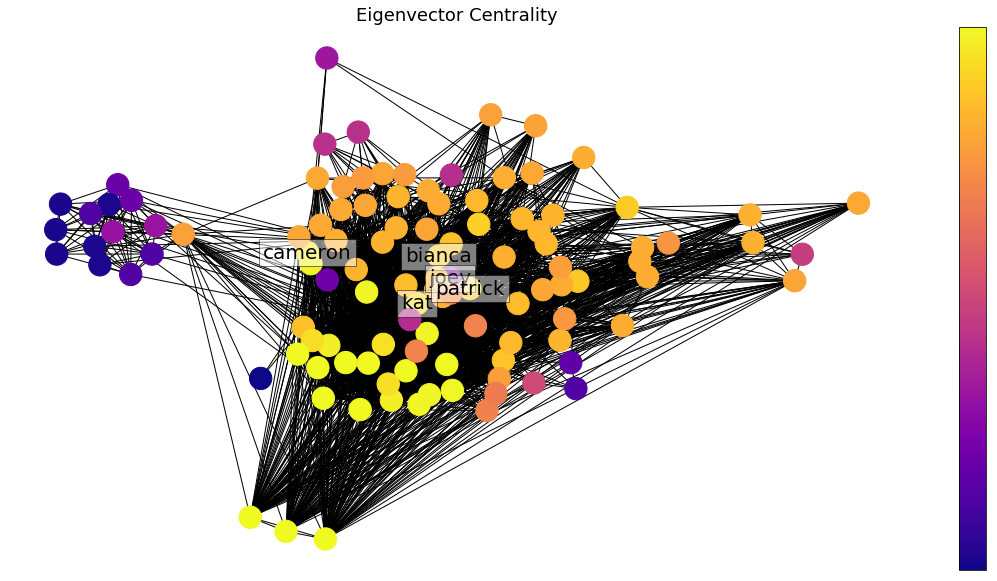

<Figure size 432x288 with 0 Axes>

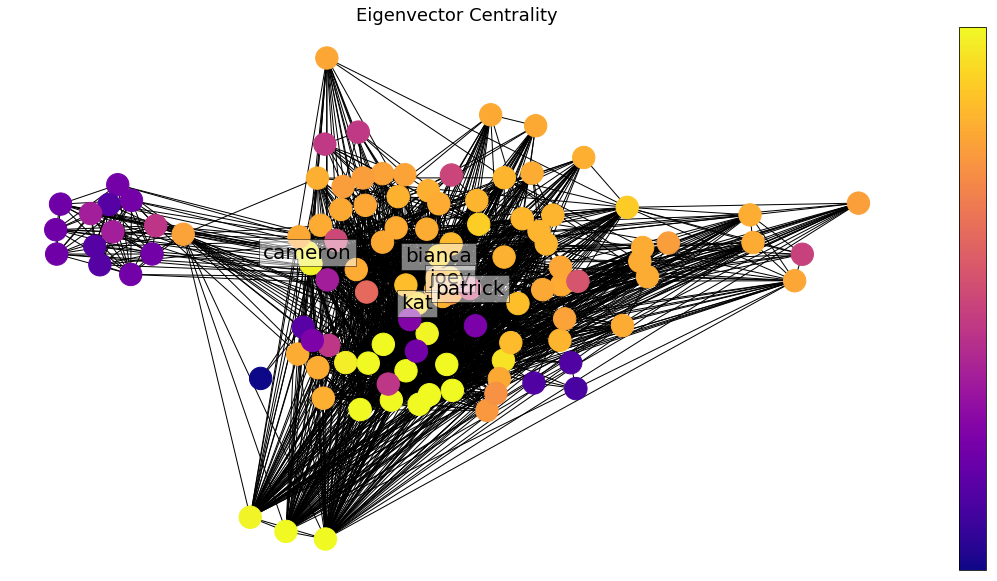

<Figure size 432x288 with 0 Axes>

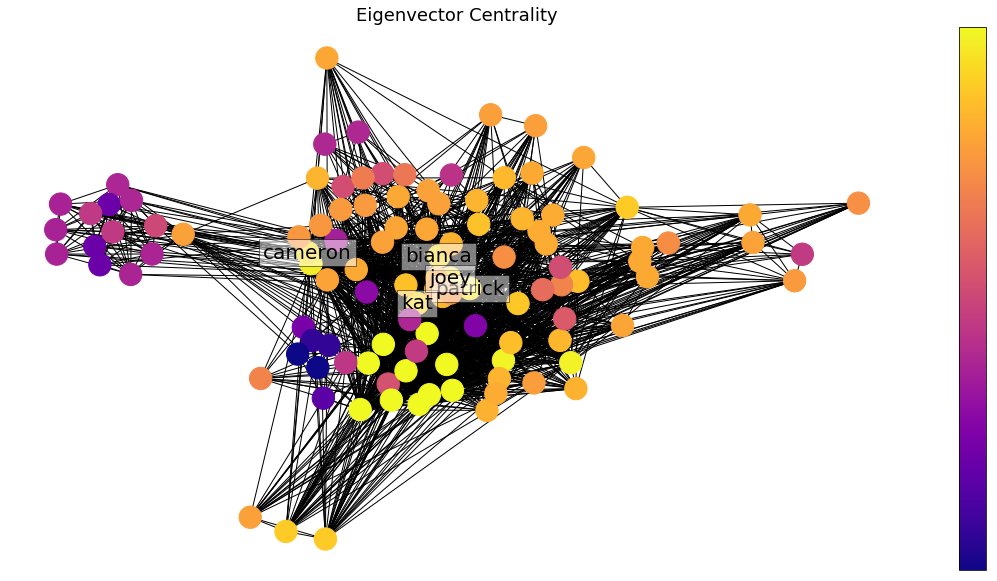

<Figure size 432x288 with 0 Axes>

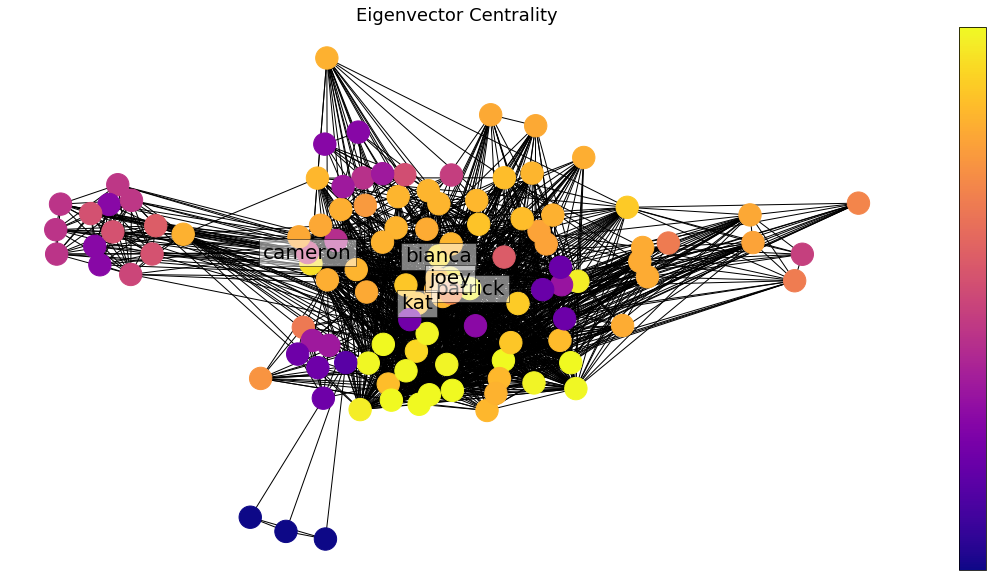

<Figure size 432x288 with 0 Axes>

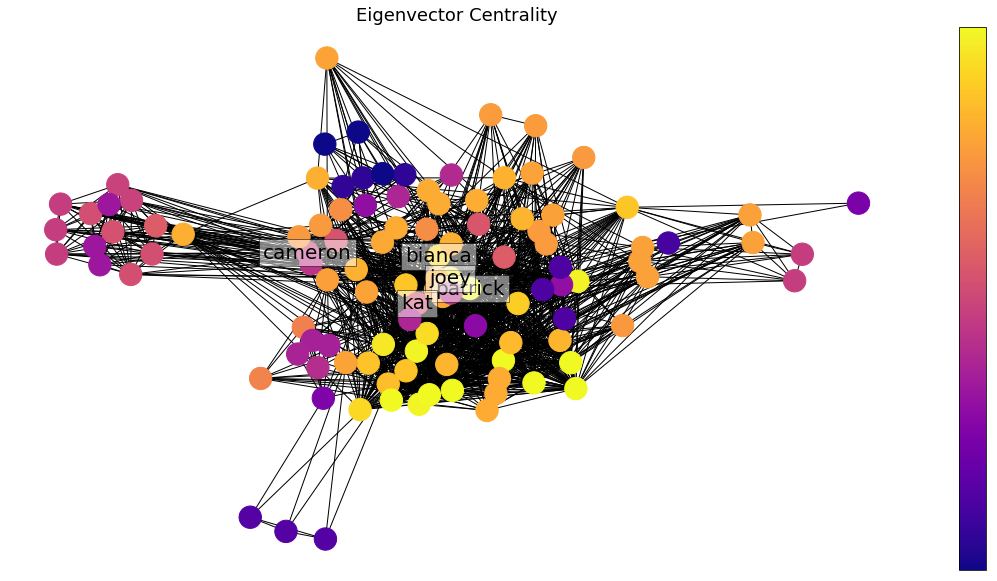

<Figure size 432x288 with 0 Axes>

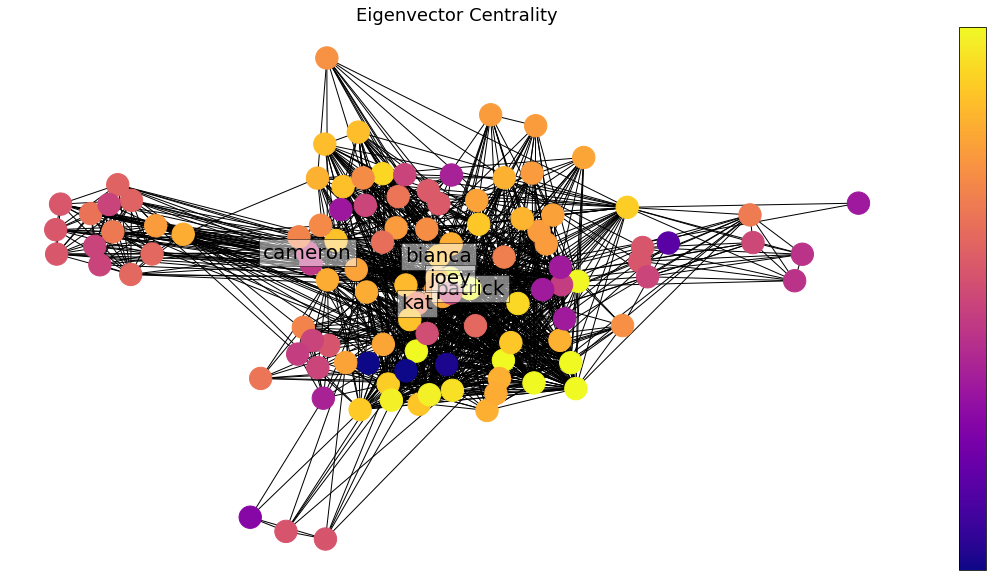

<Figure size 432x288 with 0 Axes>

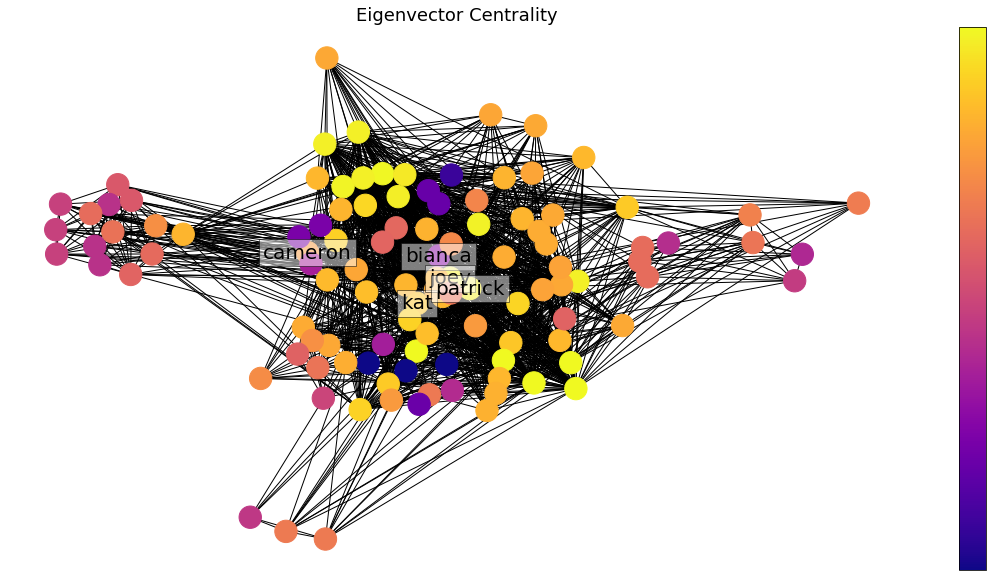

<Figure size 432x288 with 0 Axes>

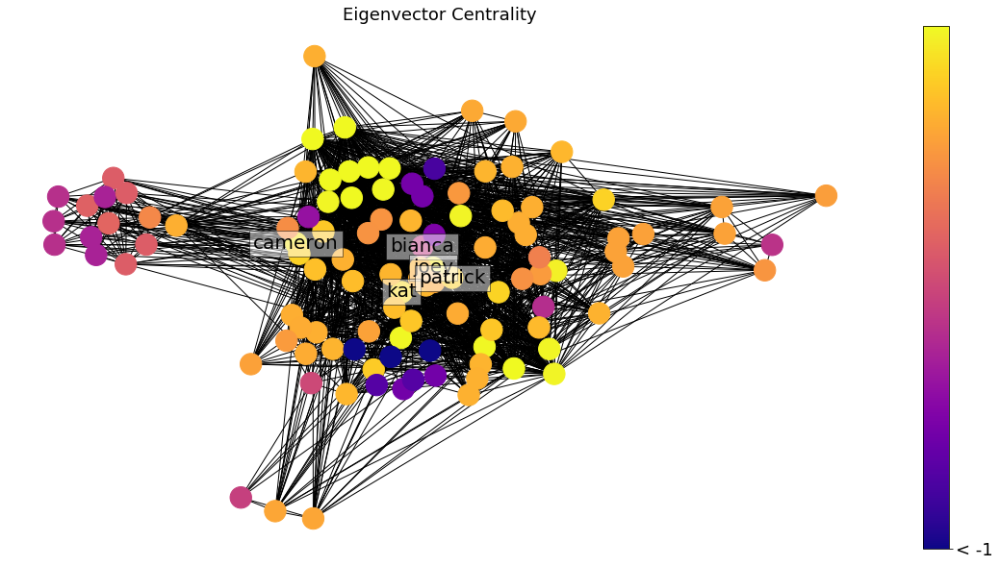

<Figure size 432x288 with 0 Axes>

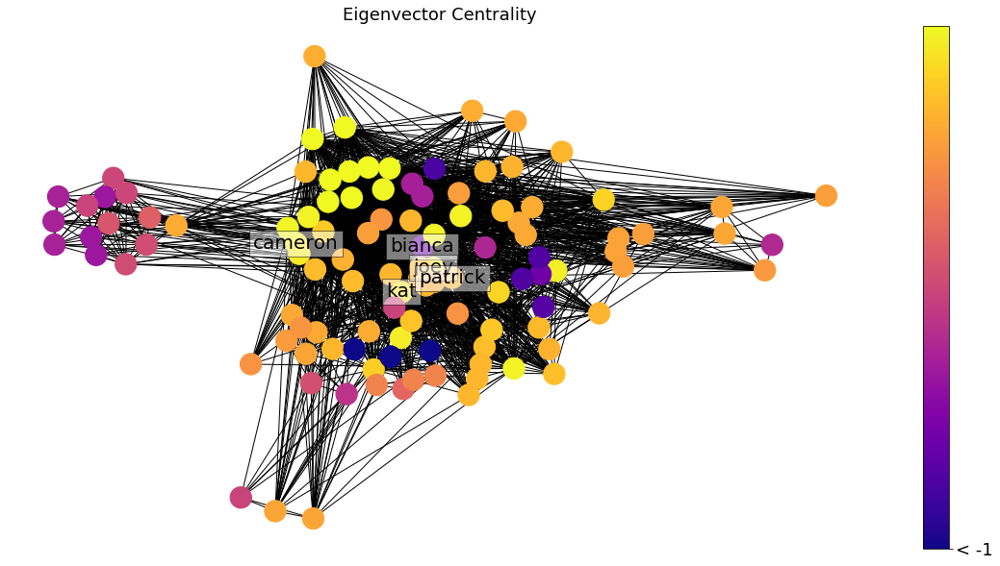

<Figure size 432x288 with 0 Axes>

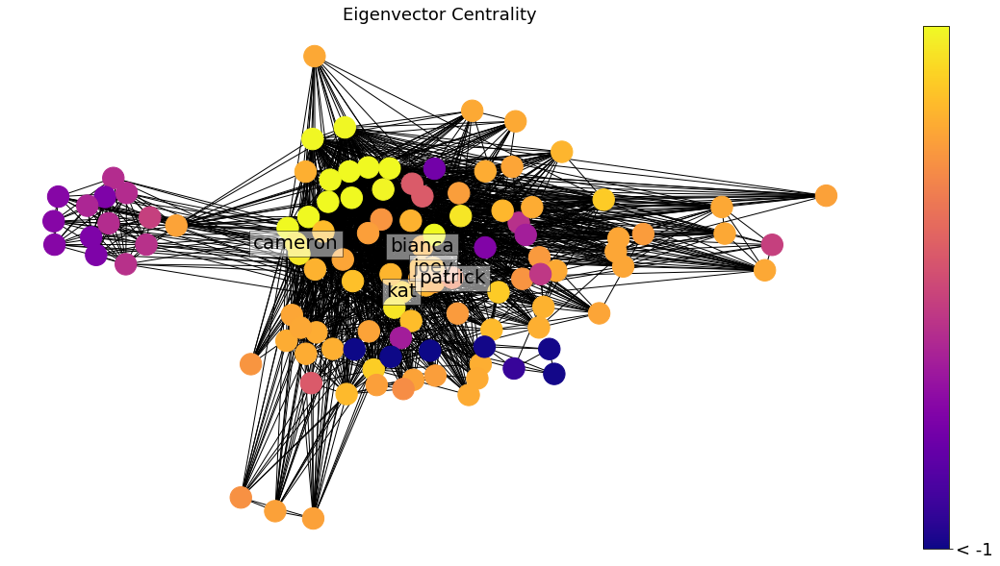

<Figure size 432x288 with 0 Axes>

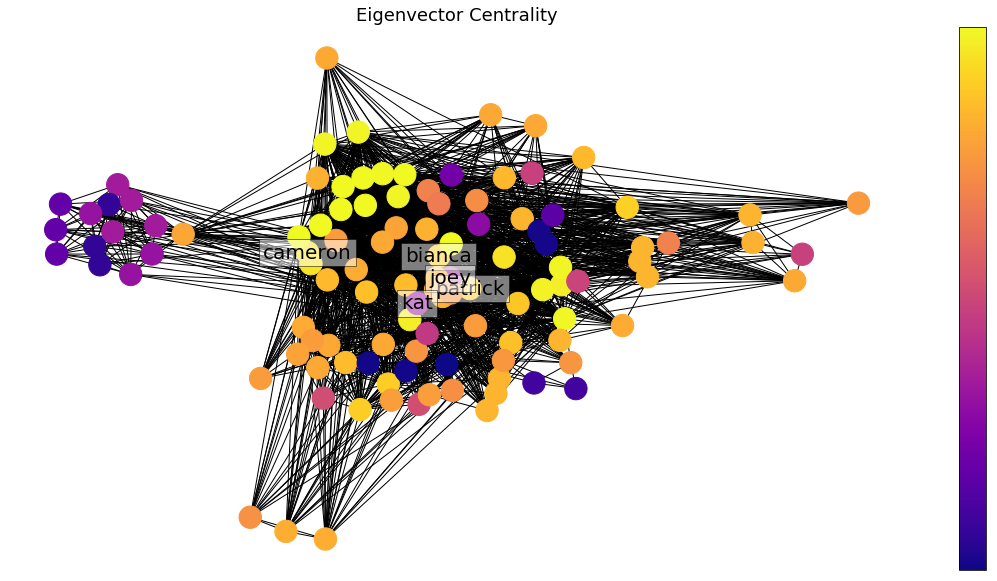

<Figure size 432x288 with 0 Axes>

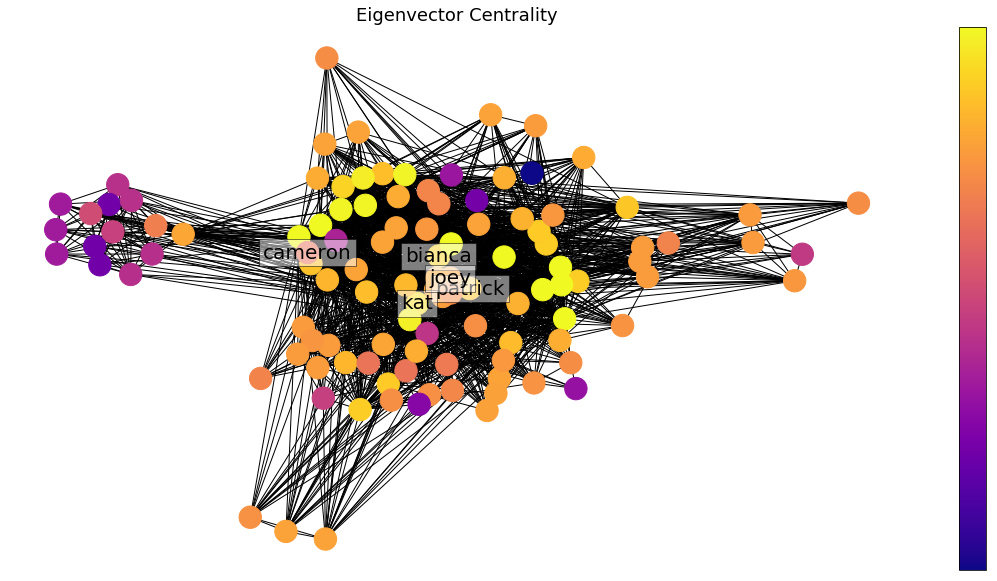

<Figure size 432x288 with 0 Axes>

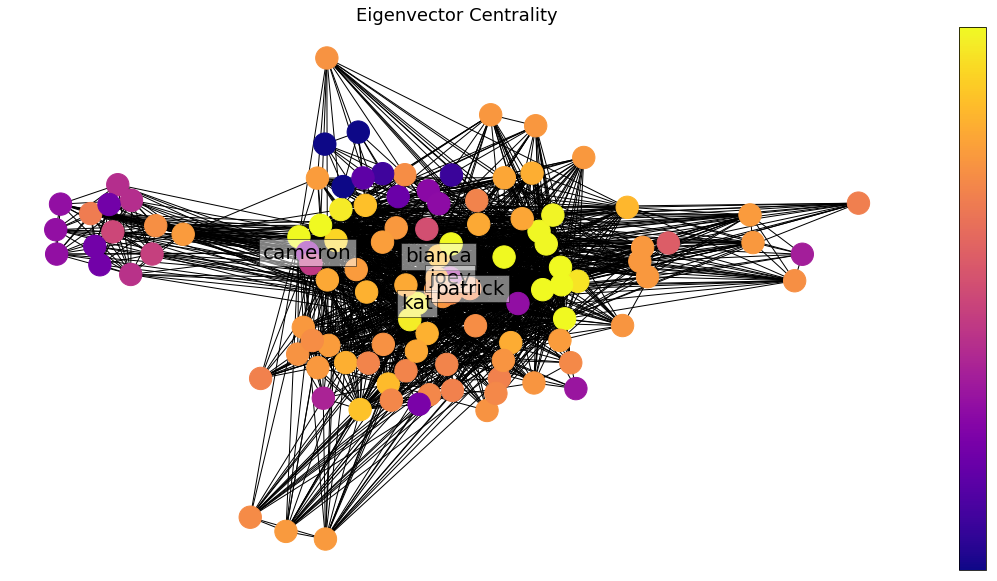

<Figure size 432x288 with 0 Axes>

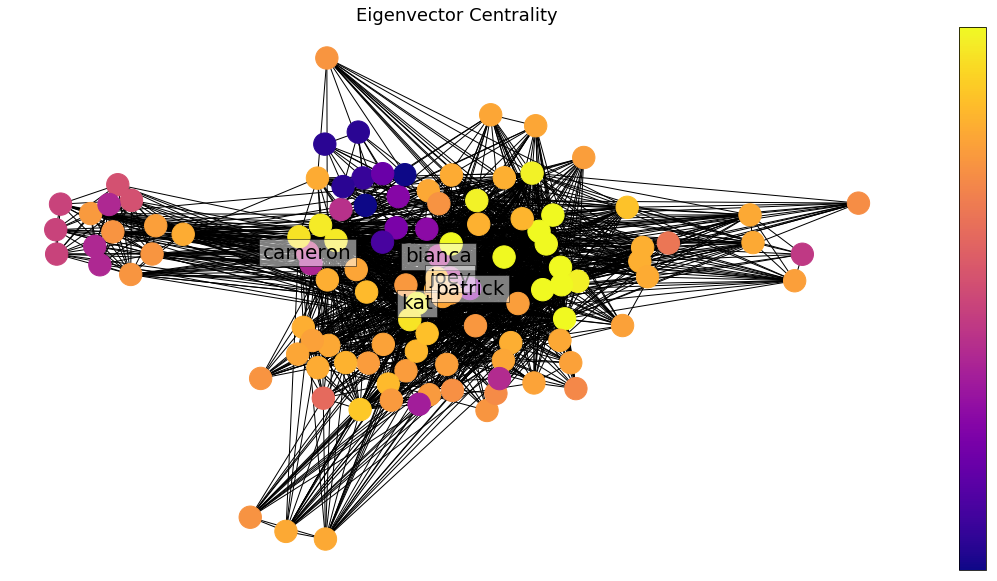

<Figure size 432x288 with 0 Axes>

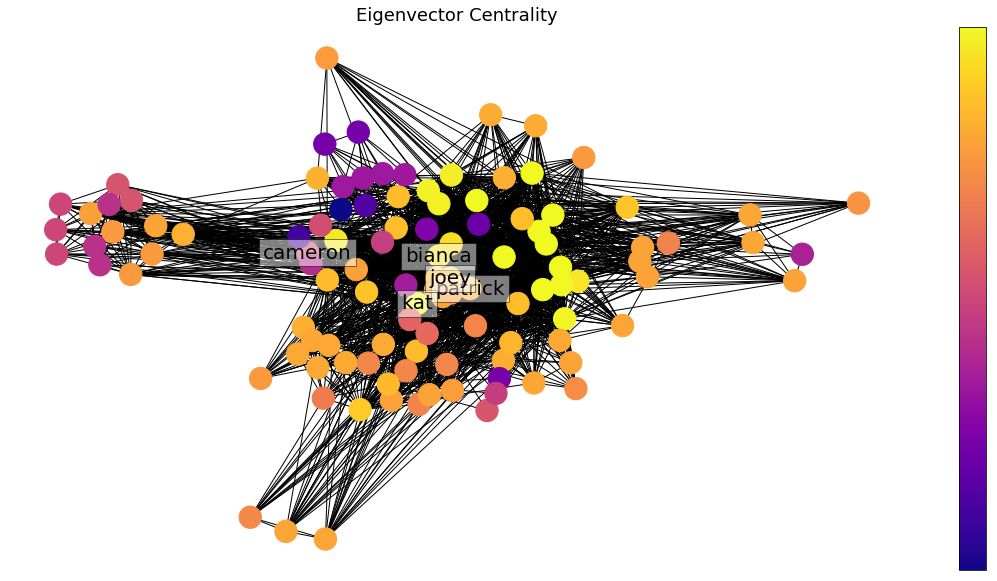

<Figure size 432x288 with 0 Axes>

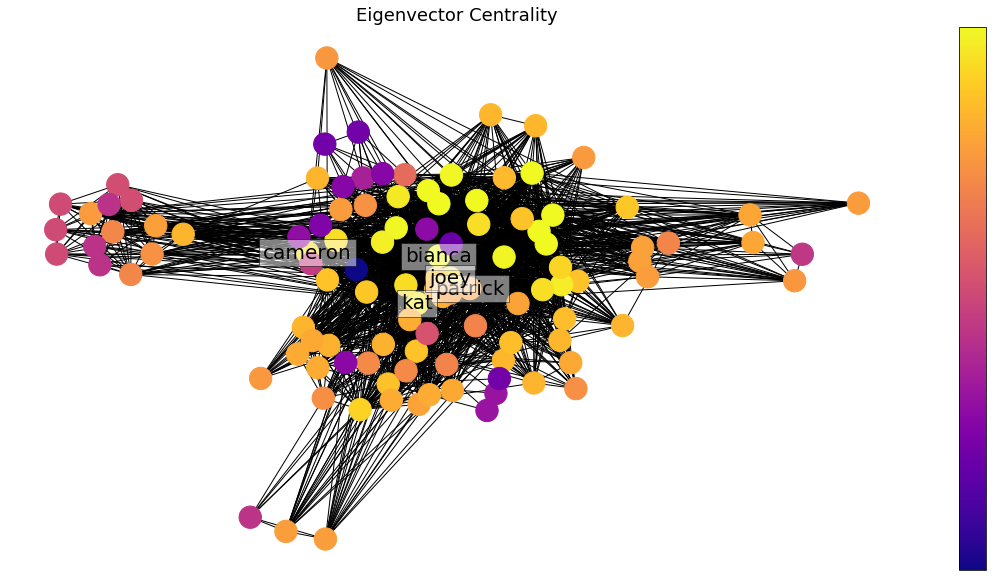

<Figure size 432x288 with 0 Axes>

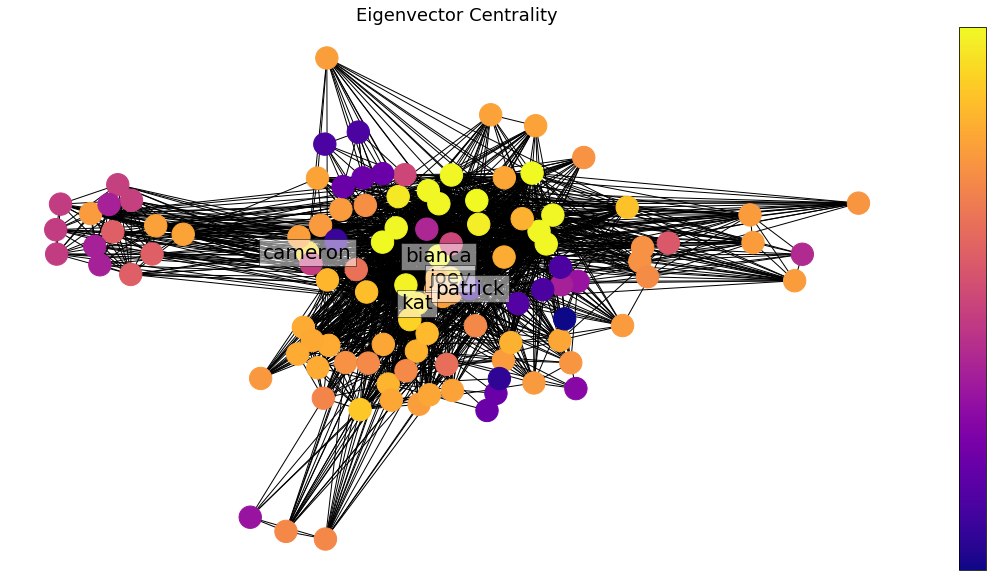

<Figure size 432x288 with 0 Axes>

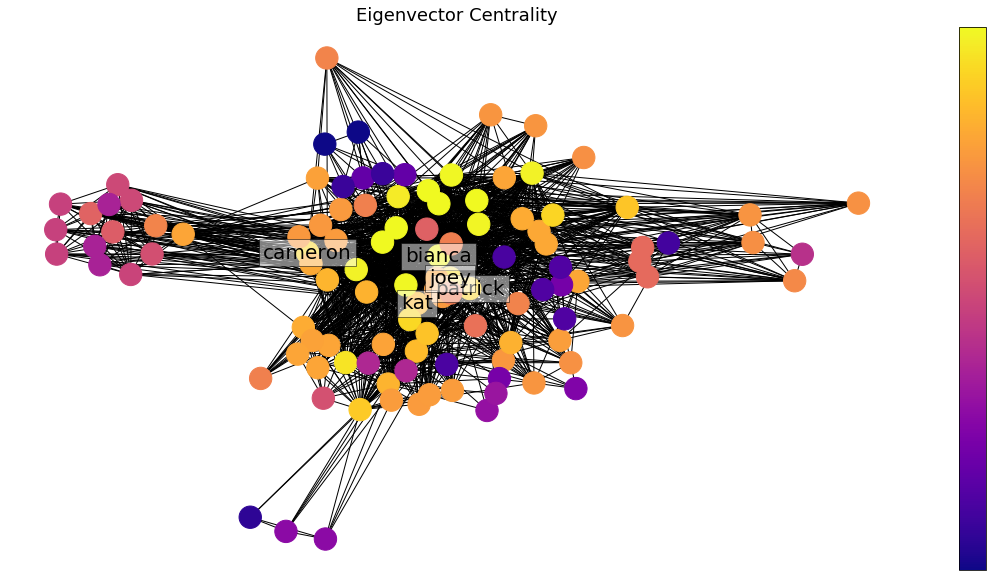

<Figure size 432x288 with 0 Axes>

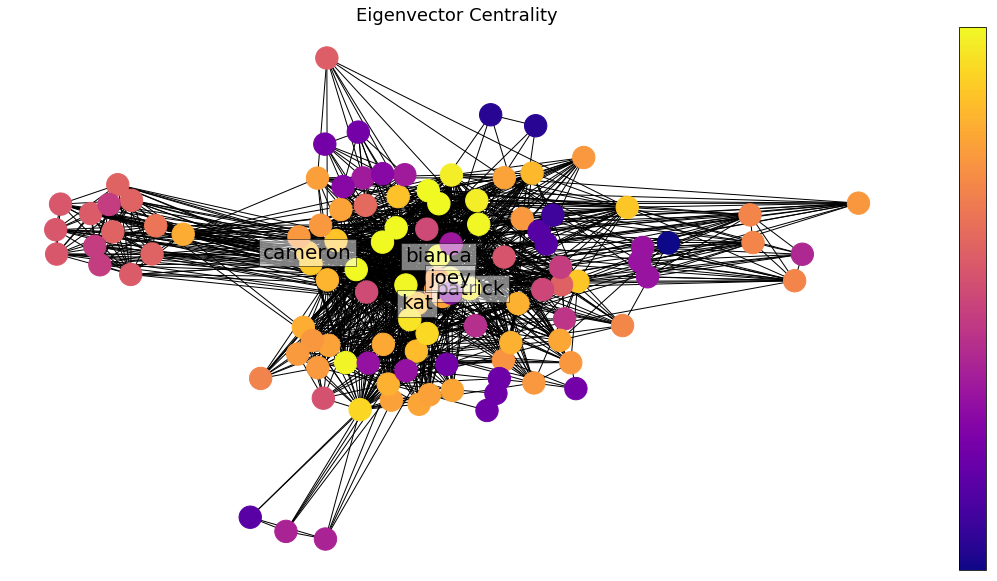

<Figure size 432x288 with 0 Axes>

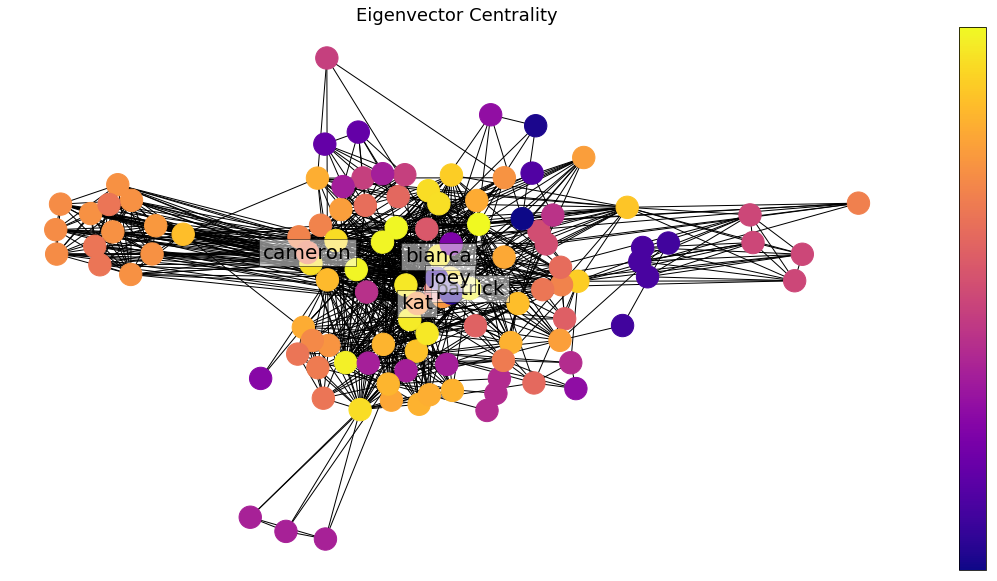

<Figure size 432x288 with 0 Axes>

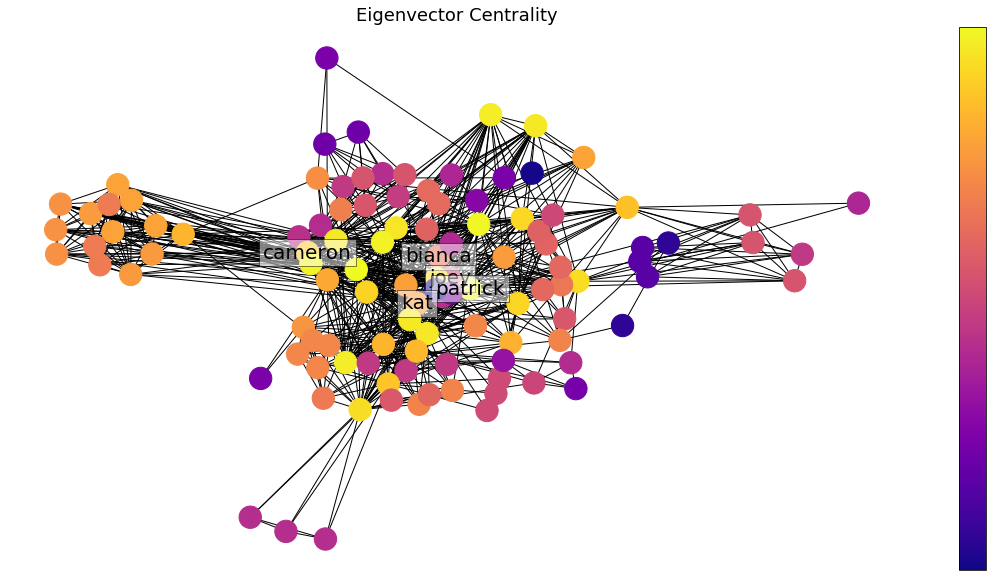

<Figure size 432x288 with 0 Axes>

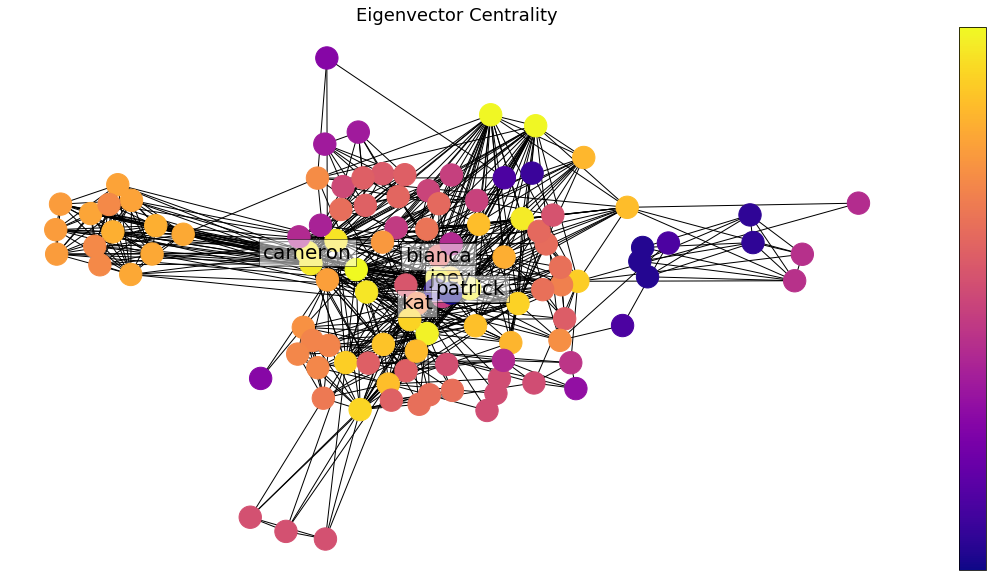

<Figure size 432x288 with 0 Axes>

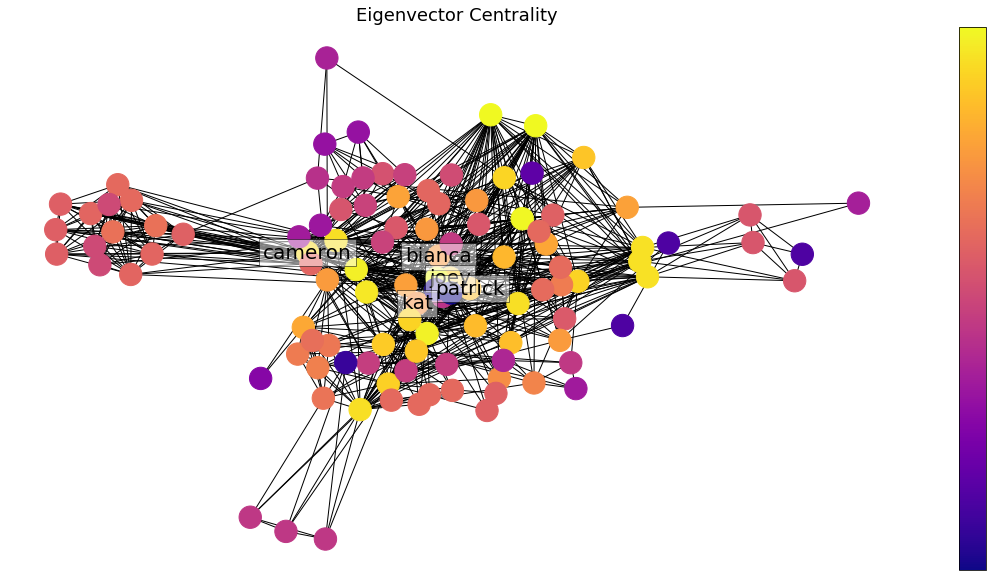

<Figure size 432x288 with 0 Axes>

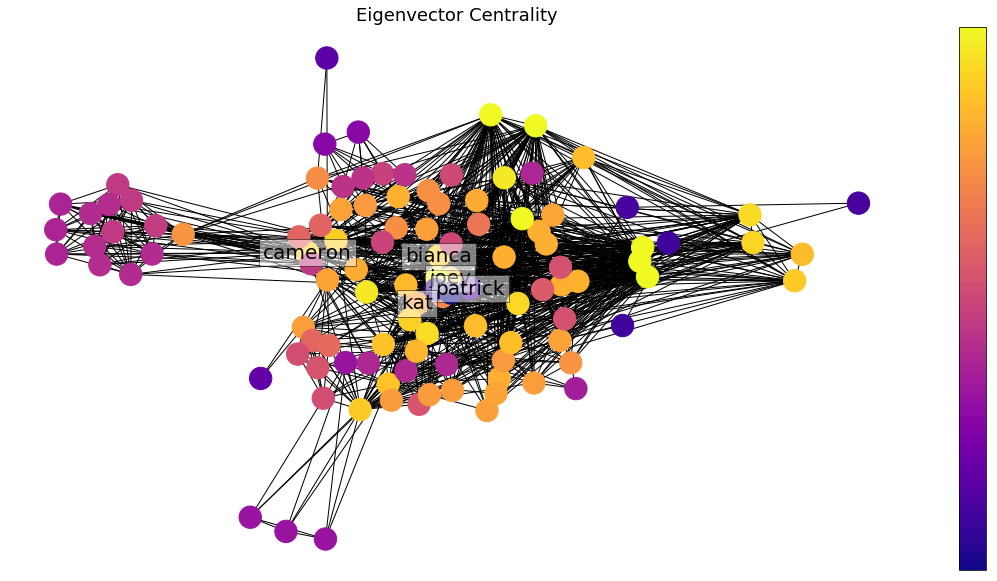

<Figure size 432x288 with 0 Axes>

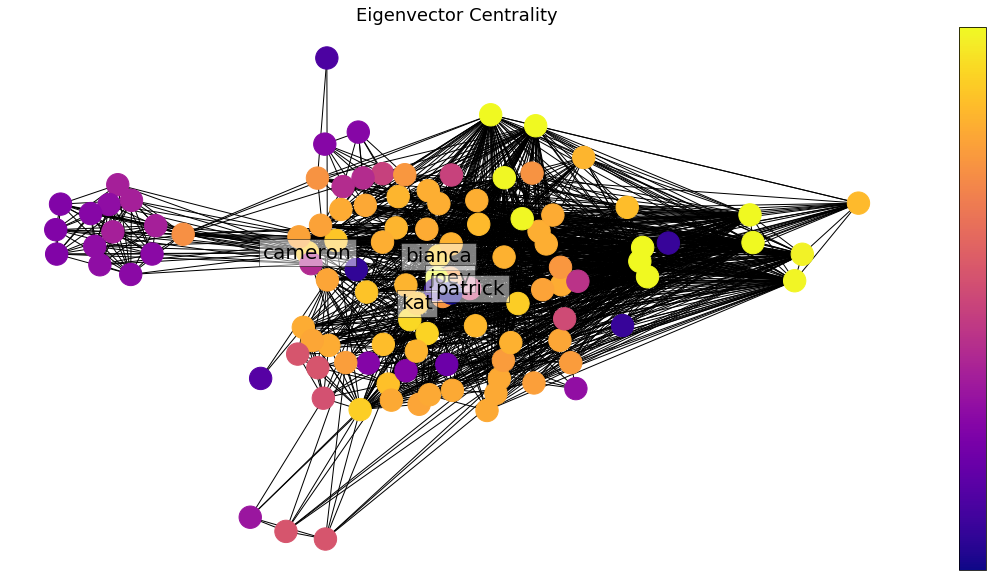

<Figure size 432x288 with 0 Axes>

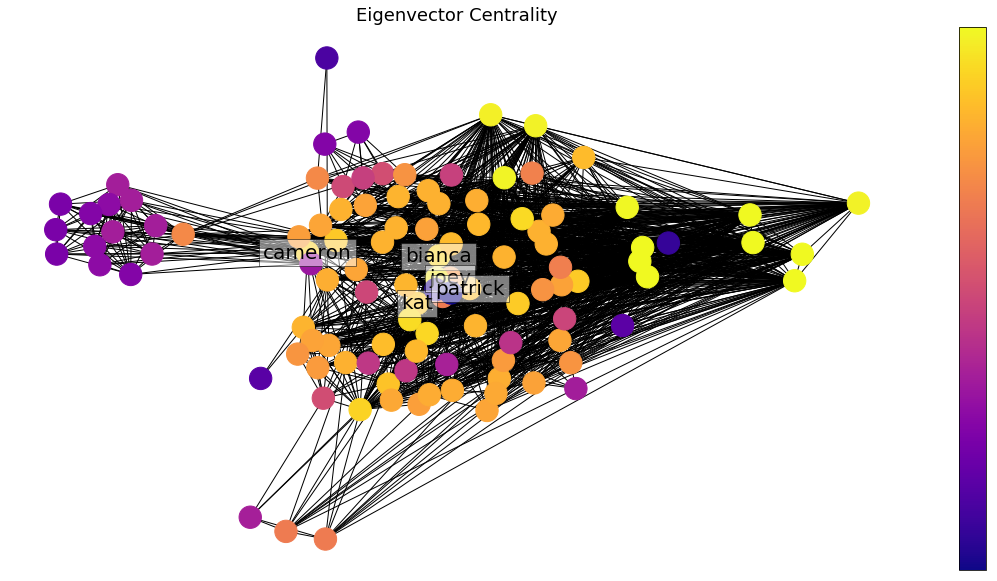

<Figure size 432x288 with 0 Axes>

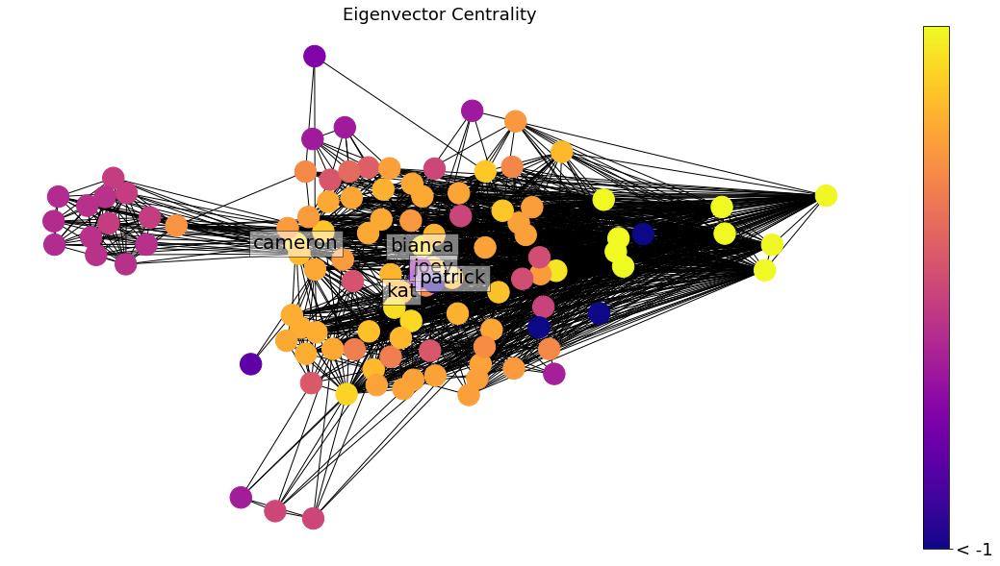

<Figure size 432x288 with 0 Axes>

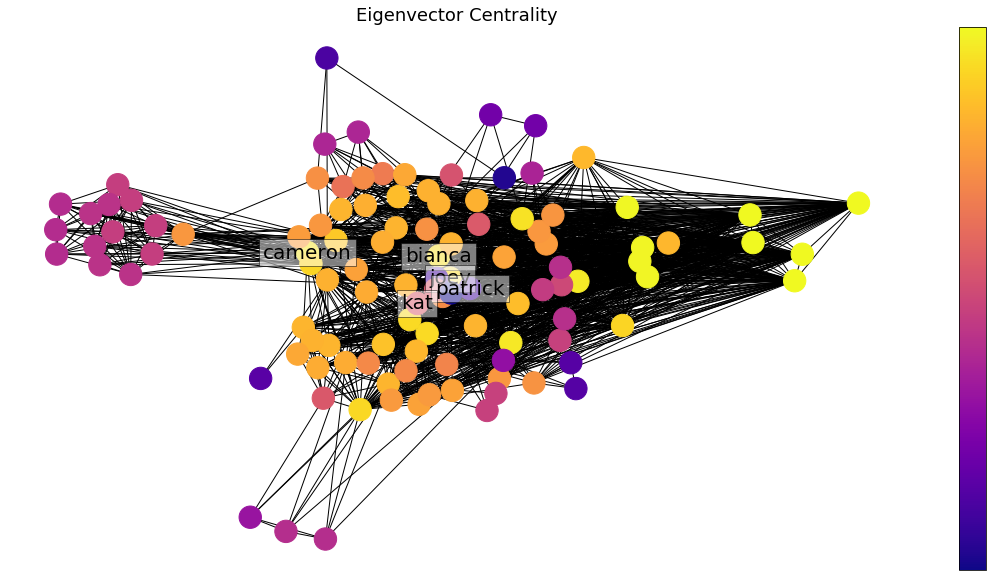

<Figure size 432x288 with 0 Axes>

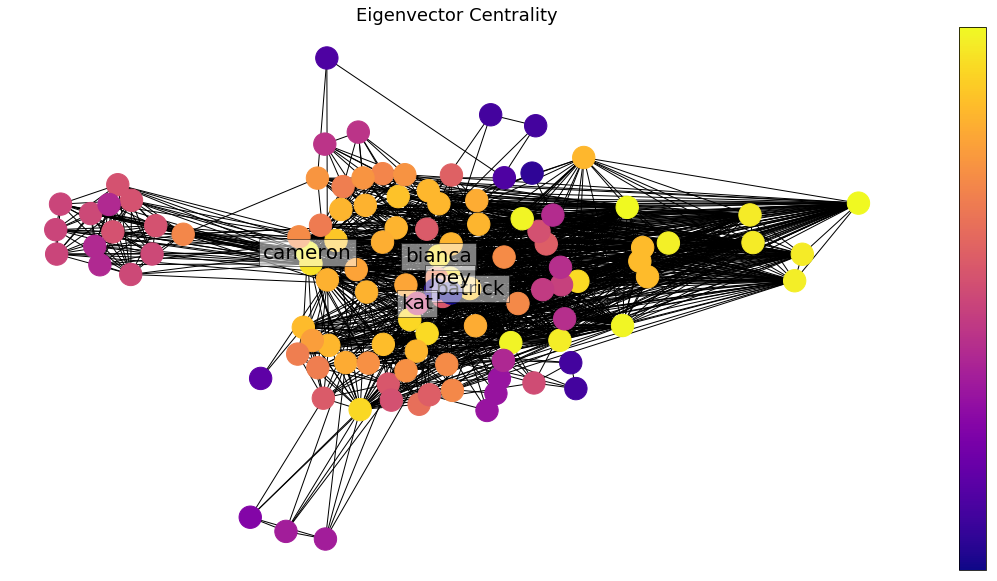

<Figure size 432x288 with 0 Axes>

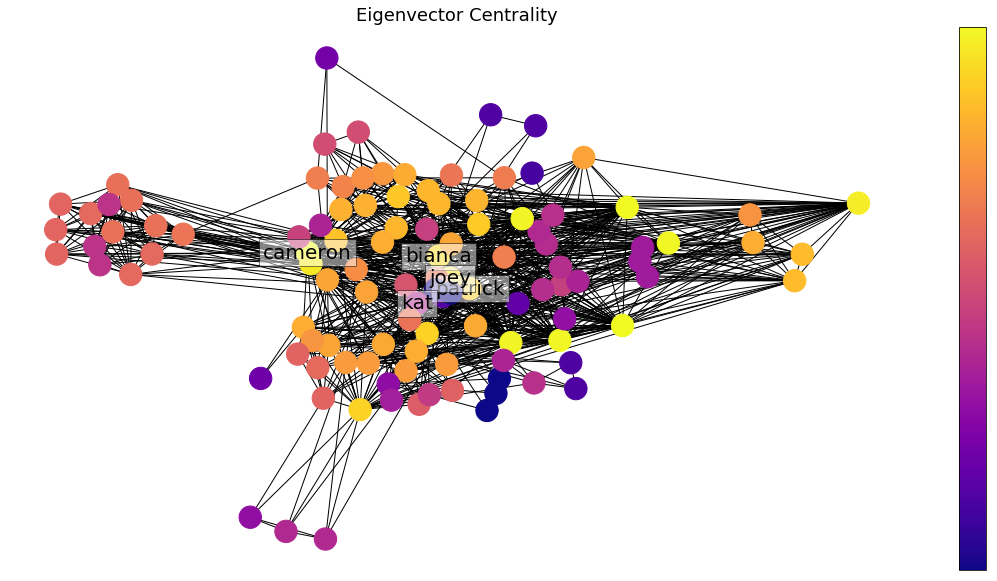

<Figure size 432x288 with 0 Axes>

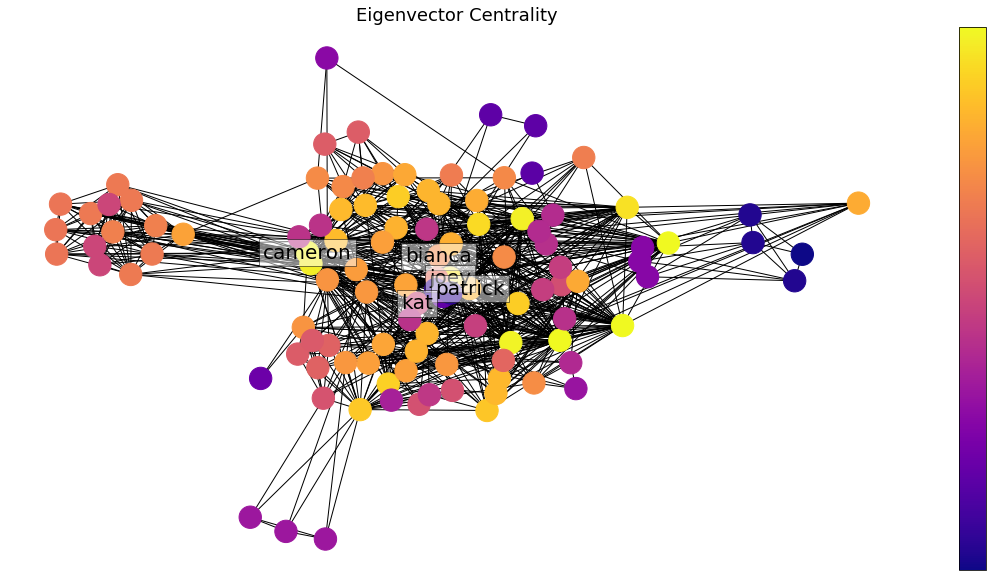

<Figure size 432x288 with 0 Axes>

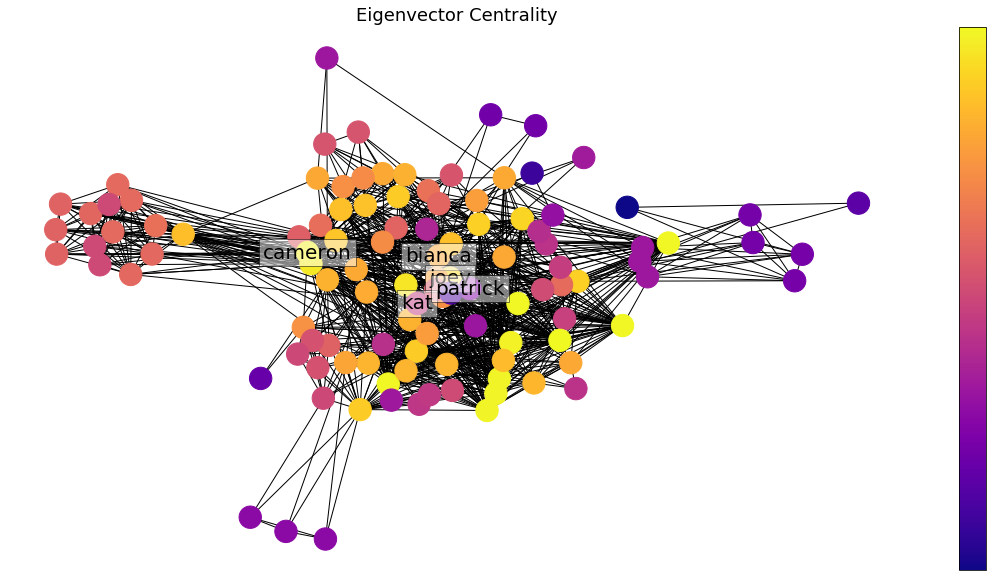

<Figure size 432x288 with 0 Axes>

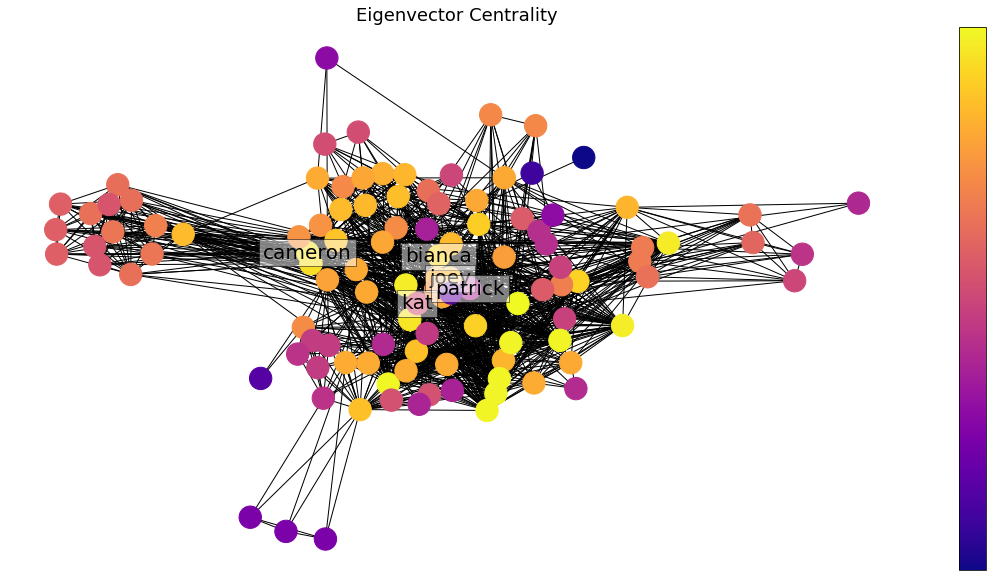

<Figure size 432x288 with 0 Axes>

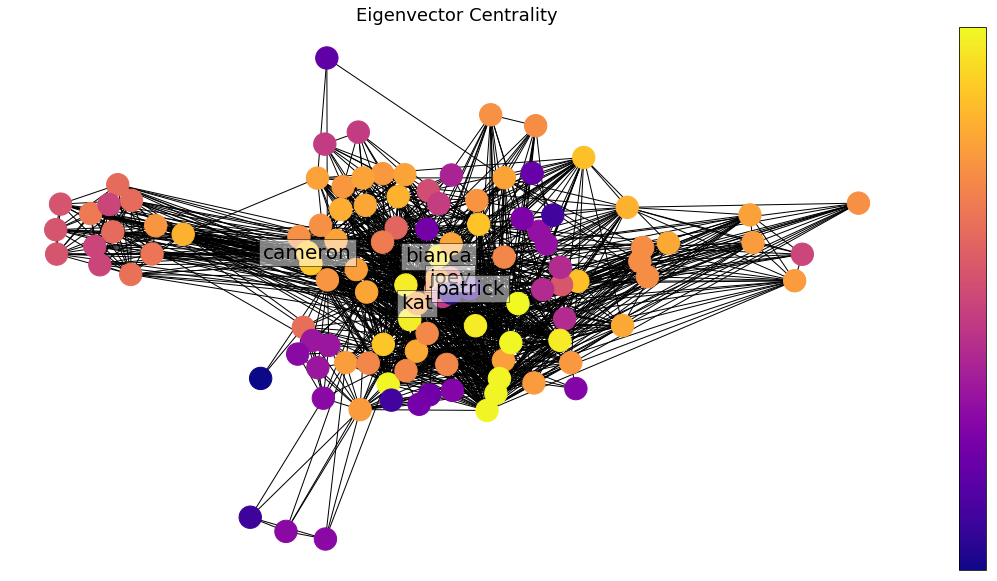

<Figure size 432x288 with 0 Axes>

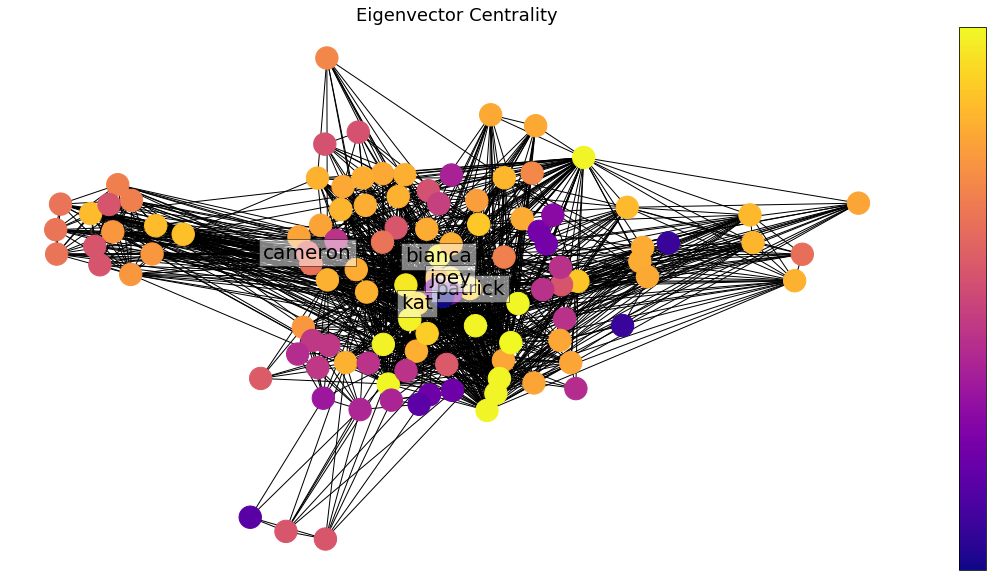

<Figure size 432x288 with 0 Axes>

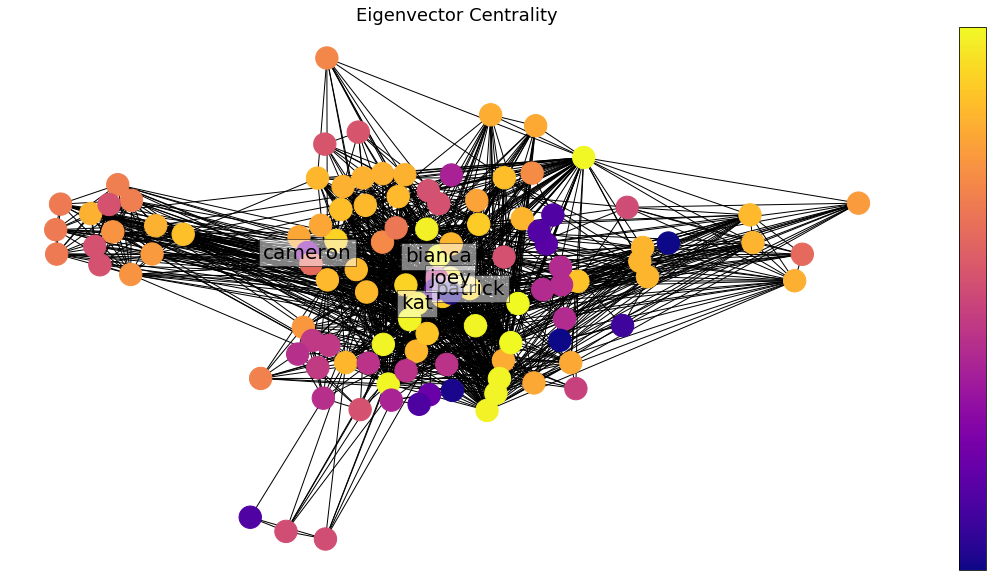

<Figure size 432x288 with 0 Axes>

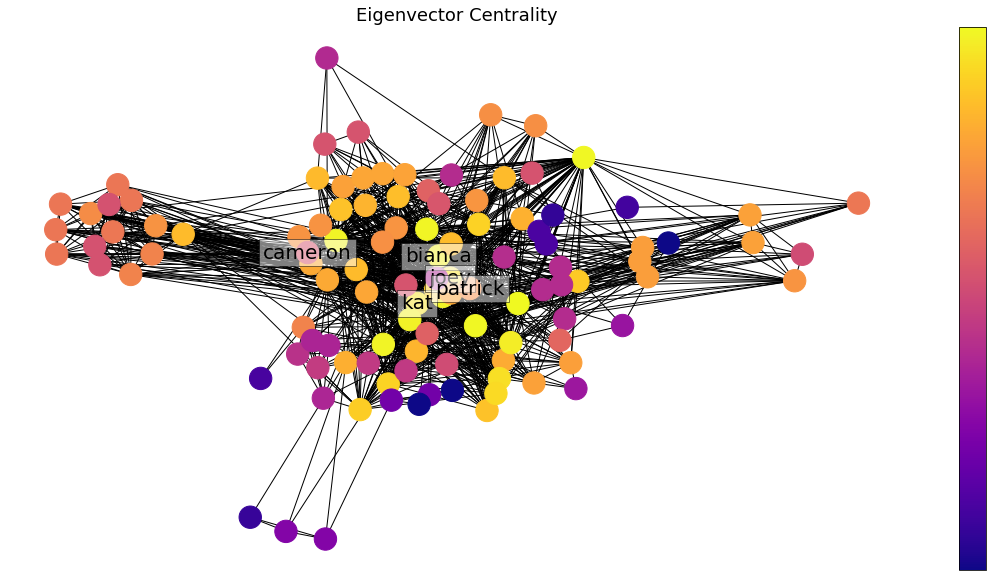

<Figure size 432x288 with 0 Axes>

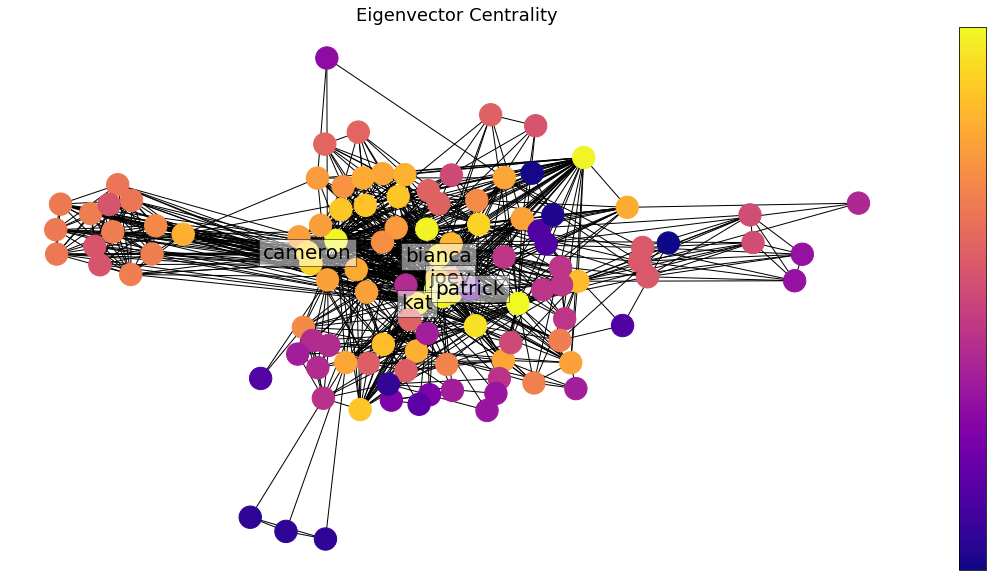

<Figure size 432x288 with 0 Axes>

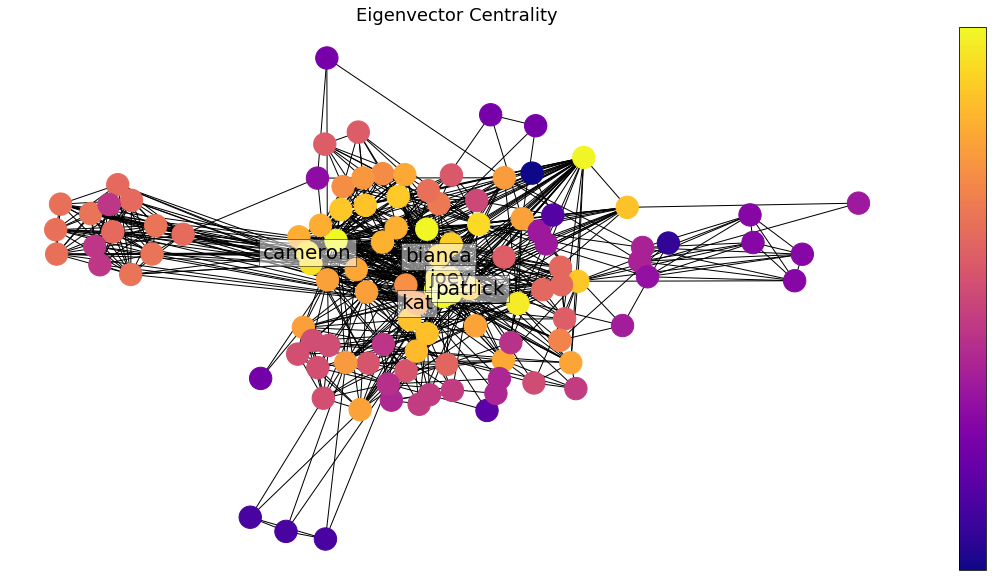

<Figure size 432x288 with 0 Axes>

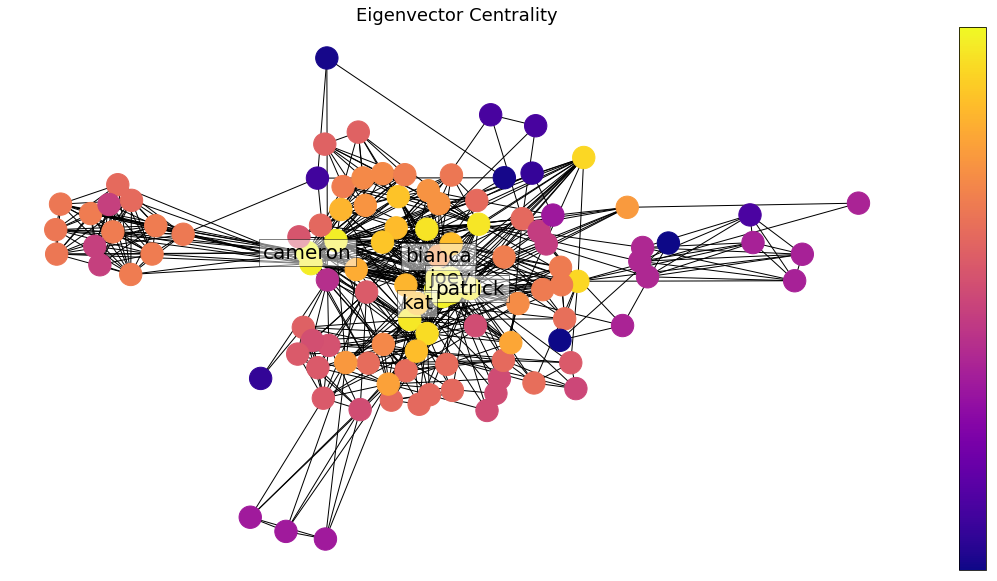

TypeError: savefig() takes 2 positional arguments but 3 were given

<Figure size 432x288 with 0 Axes>

In [90]:
gif_path = '/Users/lucyowen/Desktop/eig_try'

if not os.path.exists(gif_path):
    os.makedirs(gif_path)
    



df = pd.DataFrame(char_data[:, :, 48])
df.columns = char_list
# Calculate the correlation between individuals. We have to transpose first, because the corr function calculate the pairwise correlations between columns.
corr = df.corr()
corr

# Transform it in a links data frame (3 columns only):
links = corr.stack().reset_index()
links.columns = ['var1', 'var2','value']
links

# Keep only correlation over a threshold and remove self correlation (cor(A,A)=1)
links_filtered=links.loc[ (abs(links['value']) > 0.2) & (links['var1'] != links['var2']) ]

links_filtered

# Build your graph
G=nx.from_pandas_edgelist(links_filtered, 'var1', 'var2')

# Plot the network:
#nx.draw(G, with_labels=True, node_color='lightgray', node_size=500, edge_color='black', linewidths=1, font_size=15)

pos = nx.spring_layout(G)

for x in np.arange(0, 48, 1):
    
    
    df = pd.DataFrame(char_data[:, :, x])
    df.columns = char_list
    # Calculate the correlation between individuals. We have to transpose first, because the corr function calculate the pairwise correlations between columns.
    corr = df.corr()
    corr

    # Transform it in a links data frame (3 columns only):
    links = corr.stack().reset_index()
    links.columns = ['var1', 'var2','value']
    links

    # Keep only correlation over a threshold and remove self correlation (cor(A,A)=1)
    links_filtered=links.loc[ (abs(links['value']) > 0.35) & (links['var1'] != links['var2']) ]

    links_filtered

    # Build your graph
    G=nx.from_pandas_edgelist(links_filtered, 'var1', 'var2')

    # Plot the network:
    #nx.draw(G, with_labels=True, node_color='lightgray', node_size=500, edge_color='black', linewidths=1, font_size=15)

    pos = nx.spring_layout(G)
    
    outfile = os.path.join(gif_path, str(x).zfill(6) + '.png')
    
    draw(G, pos, nx.eigenvector_centrality(G), 'Eigenvector Centrality', hubs = ['joey', 'bianca', 'patrick', 'kat', 'cameron'], outfile=outfile)
    plt.show()
    plt.clf()
    
plt.savefig(gif_path, str(x+1).zfill(6) + '.png')
plt.savefig(gif_path, str(x+2).zfill(6) + '.png')

In [78]:
name='eig_gif'


images = []
for file in os.listdir(gif_path):
    if file.endswith(".png"):
        images.append(imageio.imread(os.path.join(gif_path, file)))

    
gif_outfile = os.path.join(gif_path, name + '.gif')  
imageio.mimsave(gif_outfile, images)


In [87]:
[x for x in char_data]

[array([[ 1.        ,  1.        ,  1.        , ...,  1.        ,
          1.        ,  1.        ],
        [ 0.09689109,  0.08515215,  0.18720449, ...,  0.06915564,
          0.32987366,  0.52922242],
        [-0.59314227, -0.49317353, -0.3529767 , ..., -0.2076184 ,
         -0.11043645, -0.01648156],
        ...,
        [ 0.37491218,  0.38554088,  0.38790718, ...,  0.4611648 ,
          0.17793203,  0.17119722],
        [ 0.09306352,  0.06860791,  0.03763736, ...,  0.26040455,
         -0.18149669, -0.46128444],
        [ 0.07979877,  0.06204802,  0.0392413 , ...,  0.2397232 ,
         -0.1640306 , -0.43108867]]),
 array([[ 0.09689109,  0.08515215,  0.18720449, ...,  0.06915564,
          0.32987366,  0.52922242],
        [ 1.        ,  1.        ,  1.        , ...,  1.        ,
          1.        ,  1.        ],
        [ 0.31088079,  0.39720856,  0.33766288, ...,  0.36167581,
          0.36179937,  0.36019572],
        ...,
        [-0.15367983, -0.16530371, -0.1544672 , ..., -

In [103]:
char_data

array([[[ 1.00000000e+000,  1.00000000e+000,  1.00000000e+000, ...,
          1.00000000e+000,  1.00000000e+000,  1.00000000e+000],
        [ 9.68910860e-002,  8.51521457e-002,  1.87204492e-001, ...,
          6.91556365e-002,  3.29873656e-001,  5.29222420e-001],
        [-5.93142273e-001, -4.93173533e-001, -3.52976698e-001, ...,
         -2.07618401e-001, -1.10436454e-001, -1.64815563e-002],
        ...,
        [ 3.74912179e-001,  3.85540882e-001,  3.87907175e-001, ...,
          4.61164799e-001,  1.77932033e-001,  1.71197222e-001],
        [ 9.30635167e-002,  6.86079136e-002,  3.76373615e-002, ...,
          2.60404546e-001, -1.81496690e-001, -4.61284438e-001],
        [ 7.97987746e-002,  6.20480223e-002,  3.92413009e-002, ...,
          2.39723198e-001, -1.64030604e-001, -4.31088675e-001]],

       [[ 9.68910860e-002,  8.51521457e-002,  1.87204492e-001, ...,
          6.91556365e-002,  3.29873656e-001,  5.29222420e-001],
        [ 1.00000000e+000,  1.00000000e+000,  1.00000000e+000

In [107]:
from __future__ import division
import numpy as np
import scipy.spatial.distance as sd
from scipy.special import gamma
from scipy.linalg import toeplitz
from scipy.optimize import minimize
from scipy.stats import ttest_1samp as ttest
import hypertools as hyp
import brainconn as bc
import pandas as pd
import warnings
from matplotlib import pyplot as plt

graph_measures = {'eigenvector_centrality': bc.centrality.eigenvector_centrality_und,
                  'pagerank_centrality': lambda x: bc.centrality.pagerank_centrality(x, d=0.85),
                  'strength': bc.degree.strengths_und}

gaussian_params = {'var': 100}
laplace_params = {'scale': 100}
eye_params = {}
t_params = {'df': 100}
mexican_hat_params = {'sigma': 10}
uniform_params = {}
boxcar_params = {'width': 10}

In [124]:
char_data.shape

(112, 112, 49)

In [ ]:
corrs

In [108]:
corrs = tc.mat2vec(char_data)

In [110]:
corrs.shape

(49, 6328)

In [111]:
get_V = lambda x: int(np.divide(np.sqrt(8 * x + 1) - 1, 2))

In [112]:
V = get_V(corrs.shape[1])

In [117]:
try_data = tc.helpers.apply_by_row(corrs, graph_measures['eigenvector_centrality'])

In [123]:
try_data

(49, 112)

In [129]:
width = 3
gaussian = {'name': 'Gaussian', 'weights': tc.gaussian_weights, 'params': {'var': width}}
#vec_corrs = tc.timecorr(try_data, rfun='eigenvector_centrality', weights_function=gaussian['weights'], weights_params=gaussian['params'])
vec_corrs = tc.timecorr(try_data, weights_function=gaussian['weights'], weights_params=gaussian['params'])
mat_corrs = tc.vec2mat(vec_corrs)



In [130]:
mat_corrs.shape

(112, 112, 49)

In [120]:
try_pcs = hyp.reduce(corrs, reduce='PCA', ndims=V)

In [122]:
try_pcs.shape

(49, 49)

In [131]:
data_r = np.asarray(tc.reduce(corrs, rfun='eigenvector_centrality'))

In [98]:
vec_data.shape

(49, 6328)

In [99]:
data_r = np.asarray(tc.reduce(vec_data, rfun='eigenvector_centrality'))

In [102]:
tc.vec2mat(data_r)

ValueError: Incompatible vector size. It must be a binomial coefficient n choose 2 for some integer n >= 2.

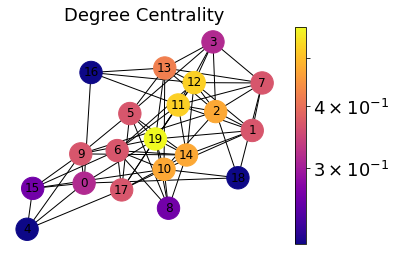

In [272]:
draw(G, pos, nx.degree_centrality(G), 'Degree Centrality')

In [173]:
#G = nx.karate_club_graph()

In [257]:
eigenvector_centrality = nx.eigenvector_centrality(G)

In [258]:
eigenvector_centrality

{0: 0.21837111939391435,
 1: 0.22895296623416625,
 2: 0.22895296623416625,
 3: 0.22895296623416625,
 5: 0.22895296623416625,
 6: 0.21837111939391438,
 7: 0.2177965882627042,
 8: 0.21837111939391438,
 9: 0.21837111939391435,
 10: 0.2065816789695639,
 11: 0.22895296623416625,
 12: 0.22895296623416625,
 13: 0.22895296623416625,
 14: 0.22895296623416625,
 15: 0.22895296623416625,
 16: 0.22895296623416625,
 17: 0.22895296623416625,
 18: 0.2177965882627042,
 19: 0.2289529662341663,
 4: 0.20658167896956384}

In [190]:
nx.set_node_attributes(G, eigenvector_centrality, 'ec')

In [191]:
sorted(G.nodes(data=True), key = lambda x: x[1]['ec'], reverse=True)

[(19, {'ec': 0.5640723727251128}),
 (0, {'ec': 0.5095022979865694}),
 (7, {'ec': 0.44908752936399293}),
 (9, {'ec': 0.38986413312629886}),
 (17, {'ec': 0.2048405107433742}),
 (12, {'ec': 0.16308427419942542}),
 (5, {'ec': 1.4905743393030506e-06}),
 (13, {'ec': 1.4905743393030506e-06}),
 (6, {'ec': 1.4905743393030506e-06}),
 (8, {'ec': 1.4905743393030506e-06}),
 (10, {'ec': 1.4905743393030506e-06}),
 (18, {'ec': 1.4905743393030506e-06})]

(0.0, 1.0, 0.0, 1.0)

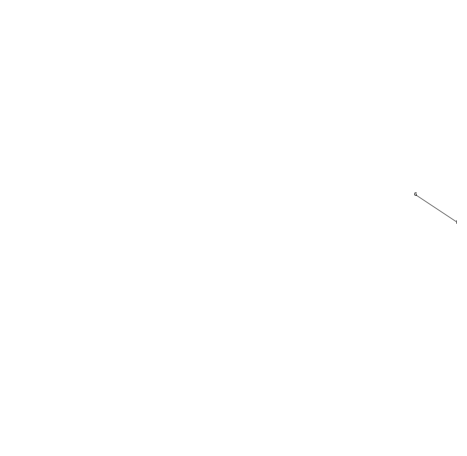

In [192]:

nodes = G.nodes(data = True)

clubs = np.unique([ data['club'] for n, data in nodes ])

plt.figure(figsize=(8, 8))

layout = nx.spring_layout(G)

colors = [ 'r', 'c' ]
for i, club in enumerate(clubs):
    color = colors[i]
    
    nodes_for_club = [ (n, data) for n, data in nodes if data['club'] == club ]
    
    for key, nodes_in_club in itertools.groupby(sorted(nodes_for_club, key=lambda x: x[1]['ec']), key=lambda x: x[1]['ec']):
        nodelist = [ n[0] for n in nodes_in_club ]
        nx.draw_networkx_nodes(
            G,
            layout,
            nodelist=nodelist,
            node_color=color,
            node_size=key*1200)

nx.draw_networkx_labels(G, layout, dict([ (n[0], n[0]) for n in nodes ]), font_size=5)
nx.draw_networkx_edges(G, layout, width=1.0, alpha=0.5)

plt.axis('off')

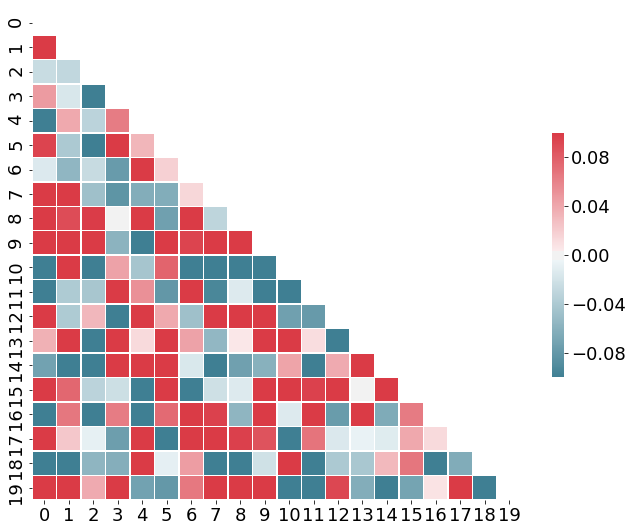

In [65]:
currmat = wcorred_data[:, :, 10]
mask = np.zeros_like(currmat, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

sns.heatmap(currmat, mask=mask, cmap=cmap, vmin=-.1, vmax=.1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

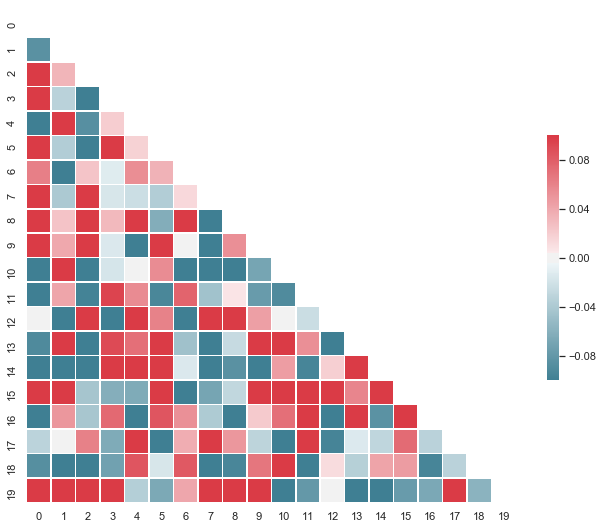

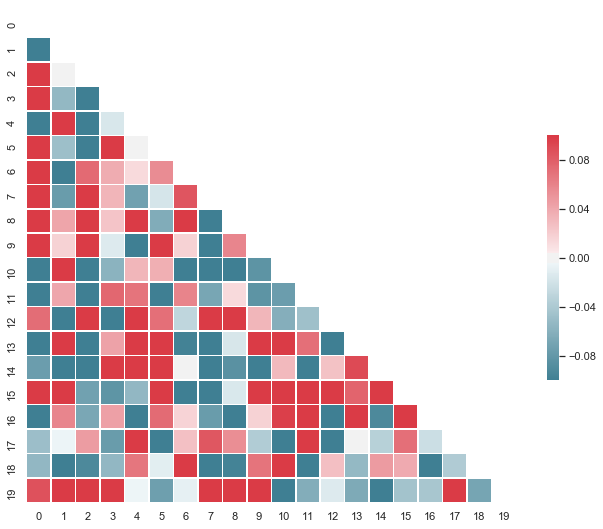

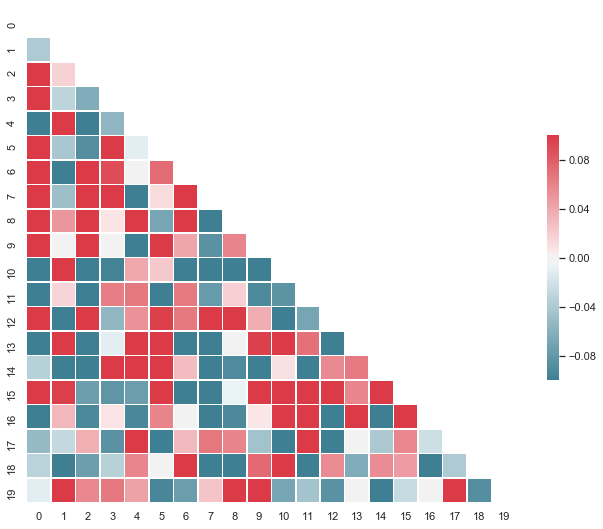

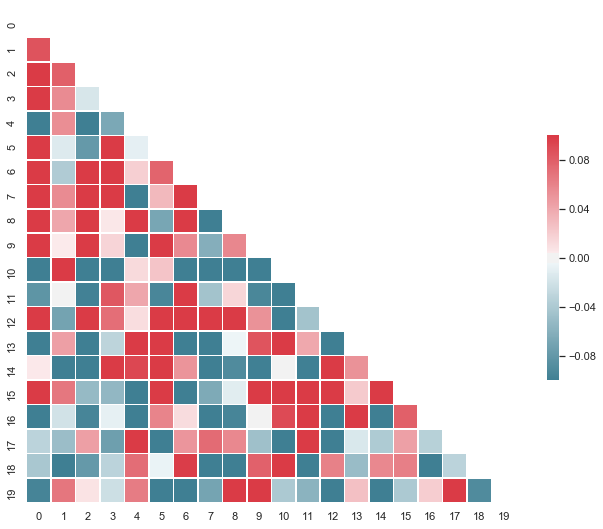

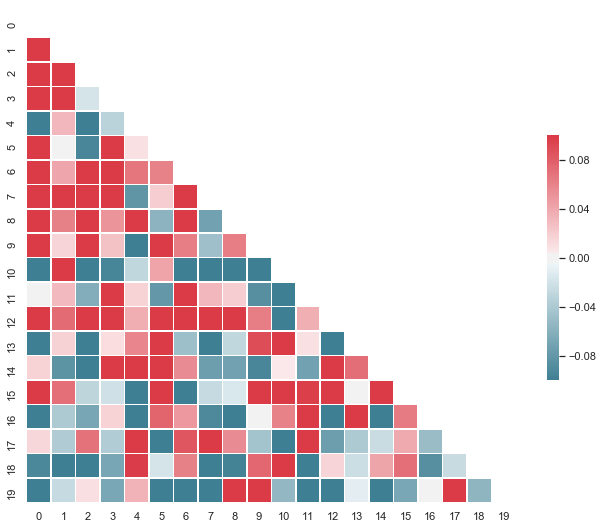

...

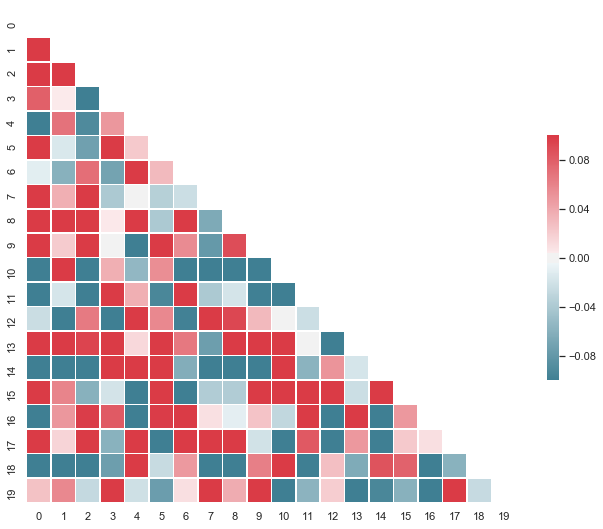

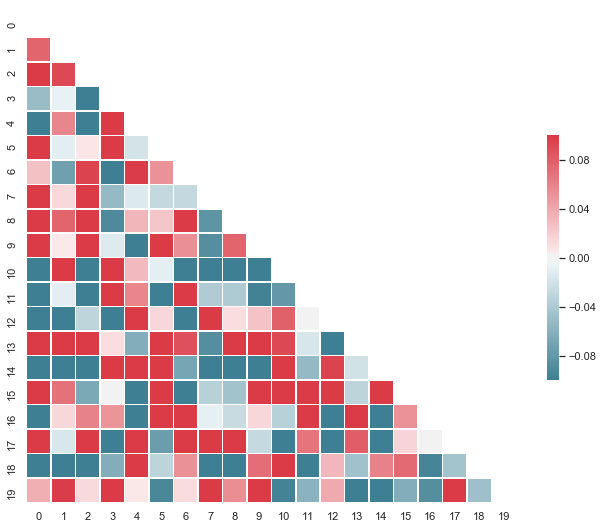

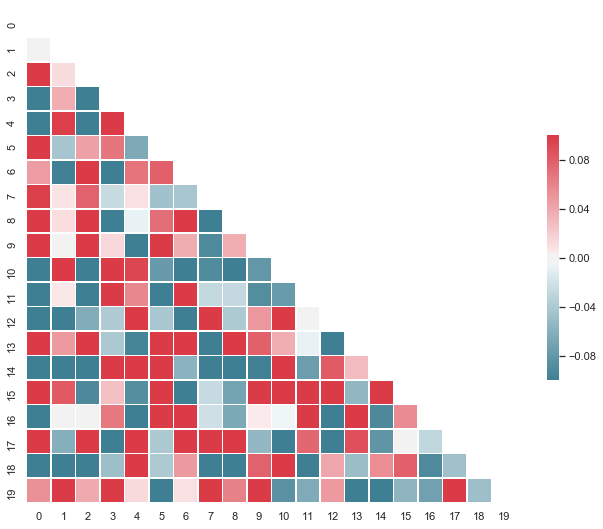

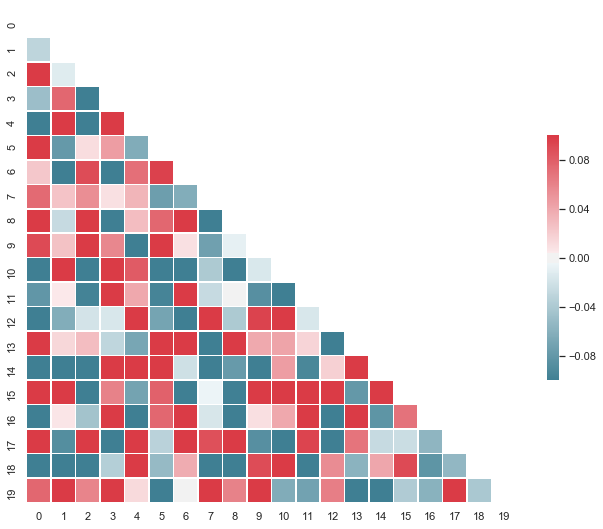

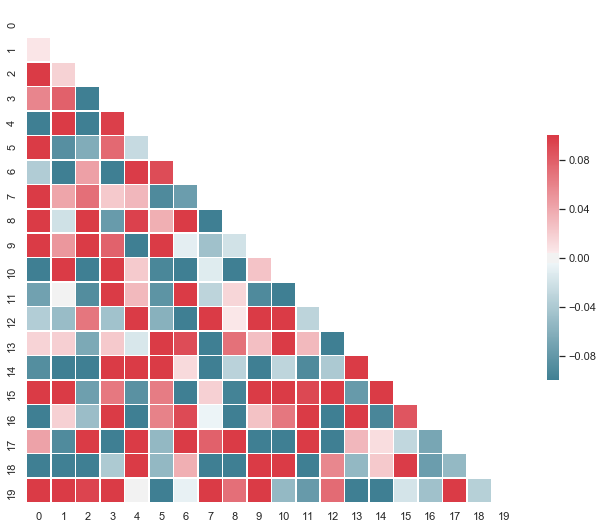

In [16]:
gif_path = '/Users/lucyowen/Desktop/tc_gif_2'

for i in range(0,(wcorred_data).shape[2],1):
    
#for i in range(0,2):
    
        
        #currmat = vec2mat(tc_data[i,:])
        currmat = wcorred_data[:, :, i]

        sns.set(style="white")

        # Generate a mask for the upper triangle
        mask = np.zeros_like(currmat, dtype=np.bool)
        mask[np.triu_indices_from(mask)] = True
        # Set up the matplotlib figure
        f, ax = plt.subplots(figsize=(11, 9))
        
        # Generate a custom diverging colormap
        cmap = sns.diverging_palette(220, 10, as_cmap=True)
        
        sns.heatmap(currmat, mask=mask, cmap=cmap, vmin=-.1, vmax=.1, center=0,
                    square=True, linewidths=.5, cbar_kws={"shrink": .5})
        #ax.text(70,10, str(i),size=40)
        outfile = os.path.join(gif_path, str(i).zfill(6) + '.png')
        plt.savefig(outfile)

In [17]:
name='try_new_gif'


images = []
for file in os.listdir(gif_path):
    if file.endswith(".png"):
        images.append(imageio.imread(os.path.join(gif_path, file)))

    
gif_outfile = os.path.join(gif_path, name + '.gif')  
imageio.mimsave(gif_outfile, images)


In [5]:
datadir = os.path.join(os.getenv('HOME'), 'Desktop', 'timecorr_env', 'timecorr_paper', 'pieman', 'data')


In [6]:
figdir = '../figs'
if not os.path.exists(figdir):
    os.mkdir(figdir)

In [7]:
factors=100

In [8]:
if factors == 100:
    pieman_name = '../../data/pieman_ica100.mat'
else:
    pieman_name = '../../data/pieman_data.mat'

pieman_conds = ['intact', 'paragraph', 'word', 'rest']

In [9]:
pieman_data = loadmat(pieman_name)

In [10]:
debug = False

In [11]:
if debug:
    data = []
    conds = []
    for c in pieman_conds:
        next_data = list(map(lambda i: pieman_data[c][:, i][0][:30, :10], np.where(np.arange(pieman_data[c].shape[1]) != 3)[0]))
        data.extend(next_data)
        conds.extend([c]*len(next_data))
    del pieman_data

else:

    data = []
    conds = []
    for c in pieman_conds:
        if c == 'paragraph':
            if factors == 700:
                next_data = list(map(lambda i: pieman_data[c][:, i][0], np.where(np.arange(pieman_data[c].shape[1]) != 3)[0]))
            else:
                next_data = list(map(lambda i: pieman_data[c][:, i][0], np.where(np.arange(pieman_data[c].shape[1]) != 0)[0]))
        else:
            next_data = list(map(lambda i: pieman_data[c][:, i][0], np.arange(pieman_data[c].shape[1])))
        data.extend(next_data)
        conds.extend([c]*len(next_data))
    del pieman_data

In [12]:
data = np.array(data)
conds = np.array(conds)

In [13]:
tc_data = tc.timecorr(list(data[conds == 'intact']), weights_function=tc.gaussian_weights, weights_params={'var': 5}, rfun=None, combine=tc.helpers.corrmean_combine)

/usr/local/lib/python3.6/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


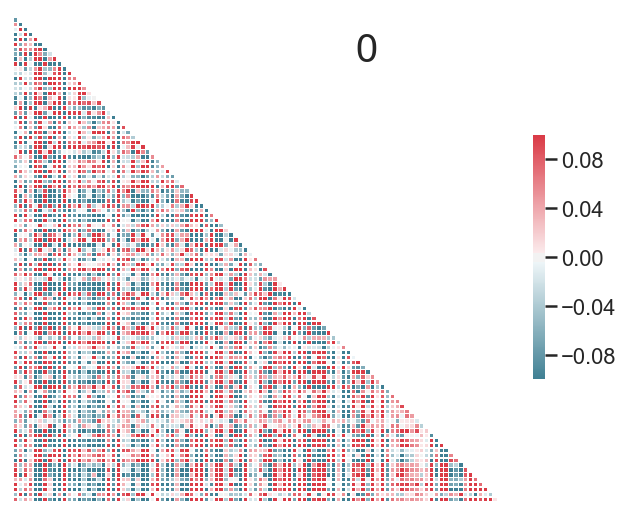

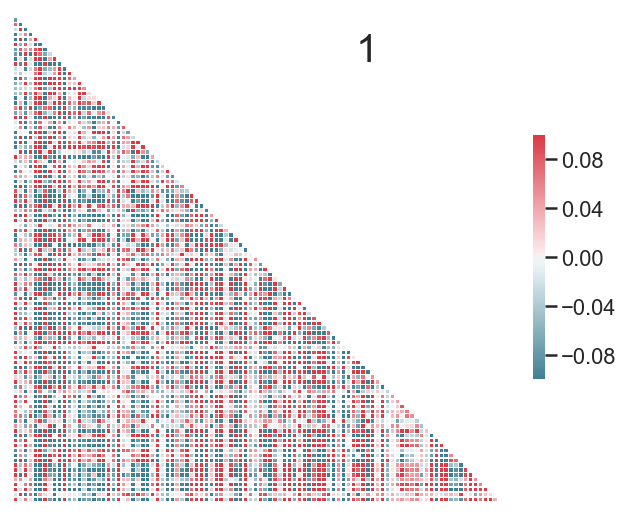

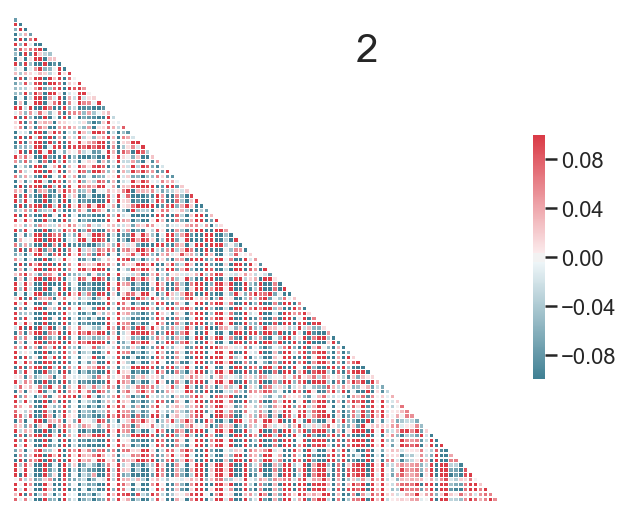

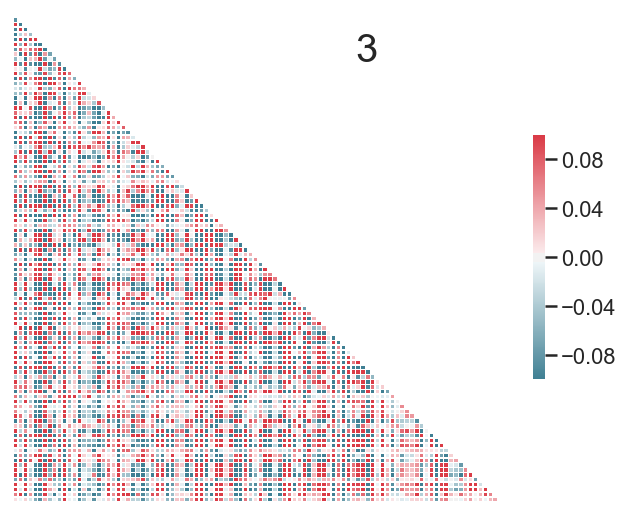

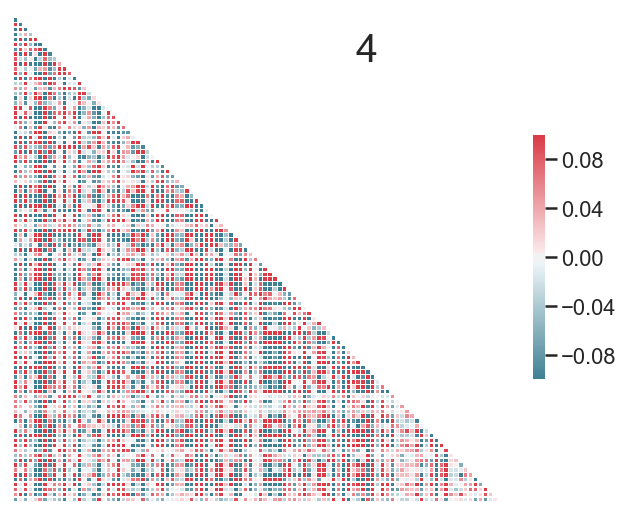

...

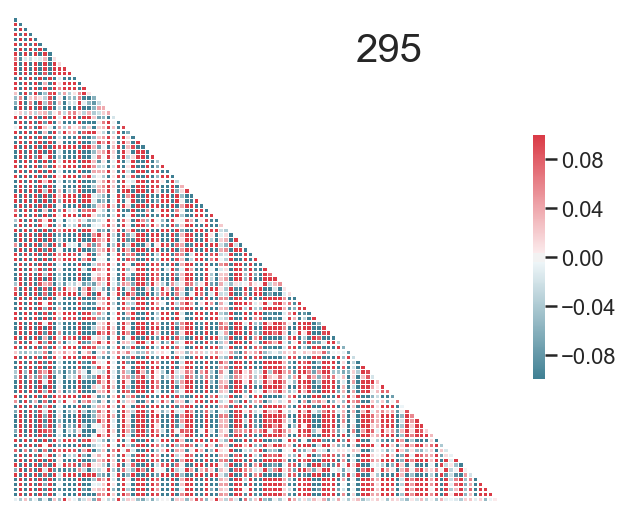

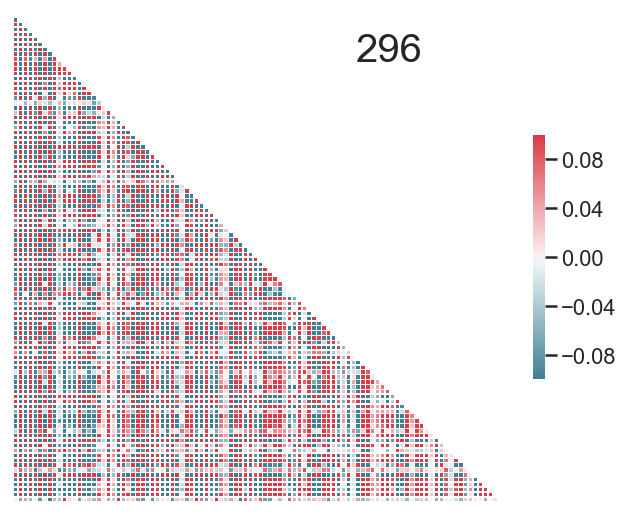

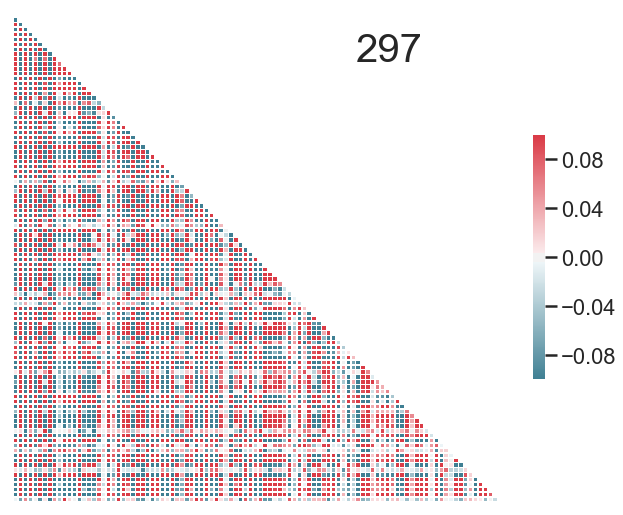

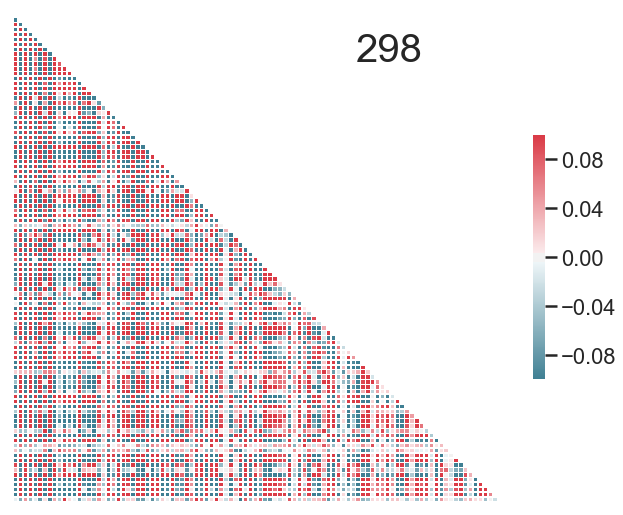

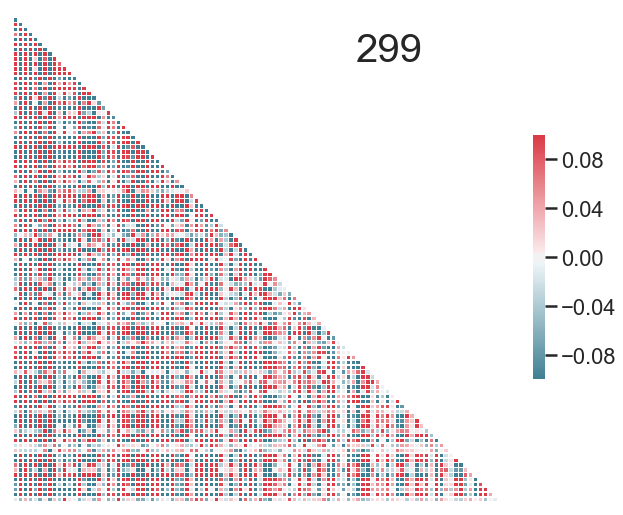

In [17]:
gif_path = '/Users/lucyowen/Desktop/tc_gif'

for i in range(0,(tc_data).shape[0],1):
    
#for i in range(0,2):
    

        currmat = vec2mat(tc_data[i,:])
        #labeled = pd.DataFrame(data = currmat, columns=latlocs['City'].as_matrix(), index=list(latlocs['City'].ravel()))        
        
        sns.set(style="white")

        # Generate a mask for the upper triangle
        mask = np.zeros_like(currmat, dtype=np.bool)
        mask[np.triu_indices_from(mask)] = True

        # Set up the matplotlib figure
        f, ax = plt.subplots(figsize=(11, 9))
        
        # Generate a custom diverging colormap
        cmap = sns.diverging_palette(220, 10, as_cmap=True)
        sns.set_context("poster")
        sns.heatmap(currmat, mask=mask, cmap=cmap, vmin=-.1, vmax=.1, center=0,
                    square=True, linewidths=.5, cbar_kws={"shrink": .5})
        ax.text(70,10, str(i),size=40)
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        outfile = os.path.join(gif_path, str(i).zfill(6) + '.png')
        plt.savefig(outfile)

In [15]:
gif_path = '/Users/lucyowen/Desktop/tc_gif'

In [18]:
# make the gif
import imageio
import os
name='100_factors'


images = []
for file in os.listdir(gif_path):
    if file.endswith(".png"):
        images.append(imageio.imread(os.path.join(gif_path, file)))

    
gif_outfile = os.path.join(gif_path, name + '.gif')  
imageio.mimsave(gif_outfile, images)
